<a href="https://colab.research.google.com/github/bhatnira/Interpretation-of-Best-Classification-Models-Acetylcholinesterase-Inhibitor-Discovery-/blob/main/ModelInterpretationAndCompoundGeneration_BestAggregrateModelCircularFingerprint.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Circular Fingerprint Based Classification Modeling with model interpretation



## Introduction

Extended-connectivity Circular Fingerprint is a topological fingerprint developed particularly for structure-activity modeling. It is flexible, fast while calculations, and has the ability to featurize any number of molecular features. Not only can ECFP be adapted to different use cases, its ability to represent substructures makes analysis more interpretable(Rogers & Hahn, 2010).

## Data loading and Preprocessing



In [1]:
import multiprocessing

print("Number of CPU cores:", multiprocessing.cpu_count())

Number of CPU cores: 2


In [3]:
# For Reporducibility
import numpy as np
np.random.seed(42)


In [27]:
!pip install numpy==1.23.3


ERROR: Operation cancelled by user


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Primary dataset

Acquisition of the primary molecular dataset of the human acetylcholinesterase inhibitor was done from ChEMBL database(ID:ChEMBL22).

In [4]:
# Load dataset
import pandas as pd
df=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/Part_2_standarizationOfMolecule/StandarizedSmiles_cutOFF800daltonMolecularweight.xlsx')
df.head(5)

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,tSNE1,tSNE2,MolecularWeight,Frequency,cleanedMol
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,-52.761700,-42.736099,275.352,27,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C
1,CHEMBL207777,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,97.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88190>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.014164,-1.325272,-63.027809,-53.765778,325.364,1,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2
2,CHEMBL205967,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,2420.0,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88270>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.235565,-1.559108,-61.968063,-54.078575,263.293,1,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2
3,CHEMBL60119,Cc1ccc2c(N)c3c(nc2c1)CCCC3,100.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88430>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,2.705664,0.148113,57.758297,-8.911607,212.296,4,Cc1ccc2c(N)c3c(nc2c1)CCCC3
4,CHEMBL294525,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2,290.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e884a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.600017,-0.978574,61.242554,5.783804,341.455,3,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2


### Features Generation






Circular fingerprints encode molecular structure by considering the environment around each atom up to a specified radius. This method captures structural information that is useful for tasks such as molecular similarity searching and property prediction. The circular fingerprint featurizer from deepchem featurizer library was adopted, documentation can be found here(DeepChem, 2024):[(Source)](https://deepchem.readthedocs.io/en/latest/api_reference/featurizers.html)

In [5]:
df.to_csv('inhibitor.csv', index=False)

In [6]:
!pip install deepchem

In [7]:
import deepchem as dc
dataset_file = 'inhibitor.csv'
task = ['classLabel']
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)
loader = dc.data.CSVLoader(tasks=task, feature_field='cleanedMol', featurizer=featurizer_func)
dataset = loader.create_dataset(dataset_file)

Instructions for updating:
experimental_relax_shapes is deprecated, use reduce_retracing instead
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECATION WARNING: please use MorganGenerator
[21:23:11] DEPRECA

In [8]:
transformer = dc.trans.BalancingTransformer(dataset=dataset)
dataset = transformer.transform(dataset)

In [10]:
pd_dataset=pd.DataFrame(dataset.X)

In [11]:
import pandas as pd
# Create a dictionary to map old column names to new column names
column_rename_map = {old_column: f"fp_{old_column}" for old_column in pd_dataset.columns}

# Rename the columns
pd_dataset.rename(columns=column_rename_map, inplace=True)

In [13]:
df_withFeatures = pd.concat([df, pd_dataset.loc[:, 'fp_0':]], axis=1)
df_withFeatures

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fp_1014,fp_1015,fp_1016,fp_1017,fp_1018,fp_1019,fp_1020,fp_1021,fp_1022,fp_1023
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,CHEMBL207777,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,97.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88190>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.014164,-1.325272,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,CHEMBL205967,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,2420.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88270>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.235565,-1.559108,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,CHEMBL60119,Cc1ccc2c(N)c3c(nc2c1)CCCC3,100.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88430>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,2.705664,0.148113,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,CHEMBL294525,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2,290.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e884a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.600017,-0.978574,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4072,CHEMBL4077157,O=C(Nc1ccc(CN2CCOCC2)cc1C(=O)C(=O)N1C(=O)CCC1=...,229.08,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327c30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.478199,1.261641,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4073,CHEMBL3906317,COc1cccc2c1C=[N+](c1ccccc1C(F)(F)F)CC2.[Br-],10000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327ca0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.671263,-0.016301,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4074,CHEMBL4800328,COc1cccc2cc[n+](-c3ccc(C)cc3)cc12.[Br-],1080.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.586529,-0.433179,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4075,CHEMBL4797670,COc1ccc(-[n+]2ccc3cccc(OC)c3c2)cc1.[Br-],140.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d80>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.677524,-0.748477,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
# Installing RDKit
!pip install rdkit

In [15]:
# Drop any feature containing null values
df_withFeatures.dropna(axis=1)

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fp_1014,fp_1015,fp_1016,fp_1017,fp_1018,fp_1019,fp_1020,fp_1021,fp_1022,fp_1023
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,CHEMBL207777,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,97.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88190>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.014164,-1.325272,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,CHEMBL205967,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,2420.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88270>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.235565,-1.559108,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,CHEMBL60119,Cc1ccc2c(N)c3c(nc2c1)CCCC3,100.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88430>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,2.705664,0.148113,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,CHEMBL294525,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2,290.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e884a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.600017,-0.978574,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4072,CHEMBL4077157,O=C(Nc1ccc(CN2CCOCC2)cc1C(=O)C(=O)N1C(=O)CCC1=...,229.08,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327c30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.478199,1.261641,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4073,CHEMBL3906317,COc1cccc2c1C=[N+](c1ccccc1C(F)(F)F)CC2.[Br-],10000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327ca0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.671263,-0.016301,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4074,CHEMBL4800328,COc1cccc2cc[n+](-c3ccc(C)cc3)cc12.[Br-],1080.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.586529,-0.433179,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4075,CHEMBL4797670,COc1ccc(-[n+]2ccc3cccc(OC)c3c2)cc1.[Br-],140.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d80>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.677524,-0.748477,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [16]:
feature1=df_withFeatures.loc[:, 'fp_0':]

In [18]:
df_withFeatures=pd.concat([df,feature1],axis=1)

In [20]:
target=df_withFeatures['classLabel']
target.head()

0    1
1    1
2    0
3    1
4    1
Name: classLabel, dtype: int64

## Loading the best performing circular fingerprint based model

In [21]:
pip install --upgrade scikit-learn==1.5.0


In [22]:
import joblib
best_model = joblib.load('/content/drive/MyDrive/Classification Models /circular_fingerprint_1024 parameters/bestModel_aggregrate_circularfingerprint_classification.pkl')


In [23]:
best_model

RandomForestClassifier(n_estimators=300)

In [24]:
import pandas as pd
df_humanIndependent=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_humanIndependent.xlsx')


In [26]:
df_humanIndependent=df_humanIndependent[['Smiles',	'binary_activities',	'cleanedMol']]

In [27]:
df_humanIndependent.rename(columns={'binary_activities': 'single-class-label'}, inplace=True)

<ipython-input-27-e096e6f94345>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_humanIndependent.rename(columns={'binary_activities': 'single-class-label'}, inplace=True)


### Featurization of Human Independent Datasets

In [28]:
df_humanIndependent.to_csv('inhibitor_HumanIndependent.csv', index=False)

In [29]:
import deepchem as dc
dataset_file = 'inhibitor_HumanIndependent.csv'
task = ['single-class-label']
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)
loader = dc.data.CSVLoader(tasks=task, feature_field='cleanedMol', featurizer=featurizer_func)
dataset_HumanIndependent = loader.create_dataset(dataset_file)

[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerator
[21:25:37] DEPRECATION WARNING: please use MorganGenerat

In [30]:
transformer = dc.trans.BalancingTransformer(dataset=dataset_HumanIndependent)
dataset_HumanIndependent = transformer.transform(dataset_HumanIndependent)

### Test dataset preparation

In [31]:
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(feature1, target, test_size=0.2, random_state=42)

In [33]:
test_df_= pd.merge(df[['cleanedMol','classLabel','IC50']], X_test, left_index=True, right_index=True, how='inner')

In [34]:
test_df_.rename(columns={'classLabel': 'single-class-label'}, inplace=True)

In [36]:
test_df_.to_csv('inhibitor_test.csv', index=False)

In [37]:
dataset_file = 'inhibitor_test.csv'
task = ['single-class-label']
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)

loader = dc.data.CSVLoader(tasks=task, feature_field='cleanedMol', featurizer=featurizer_func)
test_dataset = loader.create_dataset(dataset_file)

[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerator
[21:26:32] DEPRECATION WARNING: please use MorganGenerat

In [38]:
transformer = dc.trans.BalancingTransformer(dataset=test_dataset)
test_dataset = transformer.transform(test_dataset)

## Threshold analysis

In [40]:
feature_test=pd.DataFrame(test_dataset.X)
target=pd.DataFrame(test_dataset.y, columns=['target'])
ids=pd.DataFrame(test_dataset.ids, columns=['ids'])


In [41]:
test_dataFrame=pd.concat([ids,target,feature_test],axis=1)

In [43]:
feature_HumanIndependent=pd.DataFrame(dataset_HumanIndependent.X)
targeta=pd.DataFrame(dataset_HumanIndependent.y, columns=['target'])
idsa=pd.DataFrame(dataset_HumanIndependent.ids, columns=['ids'])


In [44]:
HumanIndependent_dataFrame=pd.concat([idsa,targeta,feature_HumanIndependent],axis=1)

Confusion Matrix for Human Test dataset:
[[416  50]
 [ 64 286]]
Confusion Matrix for Human Independent dataset:
[[133   5]
 [ 37  33]]


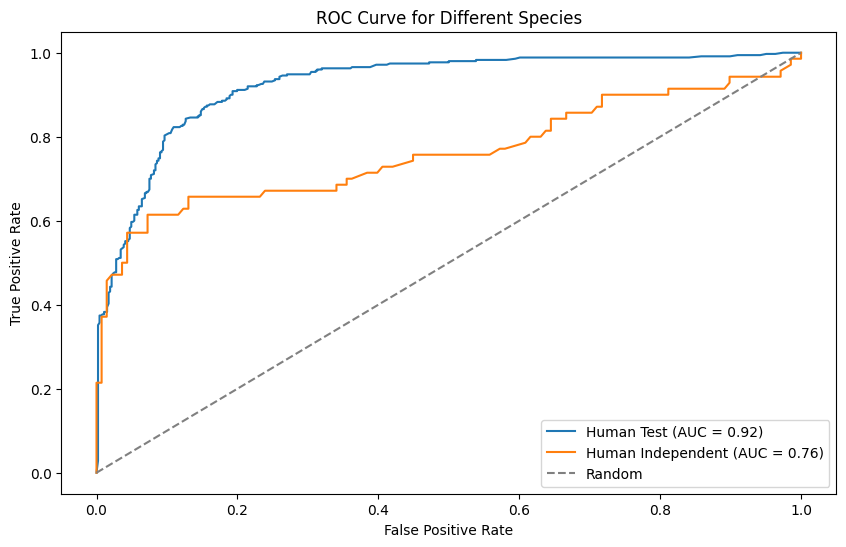

Evaluation for Human Test dataset:
Accuracy: 0.8603
Precision: 0.8512
Recall: 0.8171
F1 Score: 0.8338
MCC: 0.7138
Cohen's Kappa: 0.7134
Predicted Positives: 336.0000
Predicted Negatives: 480.0000


Evaluation for Human Independent dataset:
Accuracy: 0.7981
Precision: 0.8684
Recall: 0.4714
F1 Score: 0.6111
MCC: 0.5322
Cohen's Kappa: 0.4904
Predicted Positives: 38.0000
Predicted Negatives: 170.0000




In [46]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, cohen_kappa_score, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

datasets = {
    'Human Test': test_dataFrame,
    'Human Independent': HumanIndependent_dataFrame
}

# Set up the plot
plt.figure(figsize=(10, 6))

# Initialize a dictionary to store evaluation metrics for each dataset
evaluation_metrics = {}

# Create new datasets for predictions and probabilities
datasets_with_predictions = {}

# Evaluate and plot ROC curve for each dataset
for species, data in datasets.items():
    scaler = StandardScaler()
    X = scaler.fit_transform(data.loc[:, 0:])
    y = data['target']

    # Prediction probabilities for each class
    y_pred_probs = best_model.predict_proba(X)

    # Binary predictions
    y_pred_binary = best_model.predict(X)

    # Clone the original dataset
    new_data = data.copy()

    # Append binary predictions and prediction probabilities to the new dataset
    new_data['Binary_Prediction'] = y_pred_binary
    new_data['Class_0_Prob'] = y_pred_probs[:, 0]
    new_data['Class_1_Prob'] = y_pred_probs[:, 1]

    # Store the new dataset in the dictionary
    datasets_with_predictions[species] = new_data

    # Store the evaluation metrics in the dictionary
    evaluation_metrics[species] = {
        'Accuracy': accuracy_score(y, y_pred_binary),
        'Precision': precision_score(y, y_pred_binary),
        'Recall': recall_score(y, y_pred_binary),
        'F1 Score': f1_score(y, y_pred_binary),
        'MCC': matthews_corrcoef(y, y_pred_binary),
        "Cohen's Kappa": cohen_kappa_score(y, y_pred_binary),
        'Predicted Positives': sum(y_pred_binary == 1),
        'Predicted Negatives': sum(y_pred_binary == 0)
    }

    # Plot the ROC curve for each species
    fpr, tpr, _ = roc_curve(y, y_pred_probs[:, 1])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'{species} (AUC = {roc_auc:.2f})')

    # Display Confusion Matrix
    print(f"Confusion Matrix for {species} dataset:")
    print(confusion_matrix(y, y_pred_binary))

# Plot settings
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.title('ROC Curve for Different Species')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()

# Display or analyze the stored evaluation metrics
for species, metrics in evaluation_metrics.items():
    print(f"Evaluation for {species} dataset:")
    for metric_name, value in metrics.items():
        print(f"{metric_name}: {value:.4f}")
    print("\n")

# Create a DataFrame from the evaluation_metrics dictionary
df_metrics = pd.DataFrame(evaluation_metrics).transpose()

# Save the DataFrames to Excel files
df_metrics.to_excel('evaluation_metrics_tpot.xlsx', index_label='Species')

# Access the datasets with predictions if needed
human_test_with_predictions = datasets_with_predictions['Human Test']
human_independent_with_predictions = datasets_with_predictions['Human Independent']


In [47]:
pip install -U kaleido


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 10.1 MB/s eta 0:00:00


In [48]:
import pandas as pd
human_independent_with_predictions_filtered = human_test_with_predictions[human_test_with_predictions['target'] != human_test_with_predictions['Binary_Prediction']]

### Distribution of prediction probabilities human Independent set

In [49]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go

# Extract True Positives, True Negatives, False Positives, and False Negatives for Human Independent dataset
true_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 1) & (human_independent_with_predictions['target'] == 1)]
true_negatives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 0) & (human_independent_with_predictions['target'] == 0)]
false_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 0) & (human_independent_with_predictions['target'] == 1)]
false_negatives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 1) & (human_independent_with_predictions['target'] == 0)]

# Create subplots for Human Independent dataset
fig_hi = sp.make_subplots(rows=1, cols=1, subplot_titles=['Human Independent'])

# Add violin traces for Human Independent
fig_hi.add_trace(go.Violin(x=true_positives_hi['Binary_Prediction'], y=true_positives_hi['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=false_positives_hi['Binary_Prediction'], y=false_positives_hi['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=true_negatives_hi['Binary_Prediction'], y=true_negatives_hi['Class_1_Prob'], name='True Negatives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=false_negatives_hi['Binary_Prediction'], y=false_negatives_hi['Class_1_Prob'], name='False Negatives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))

# Update layout for better presentation
fig_hi.update_layout(
    template='plotly_white',
    title='Violin Plots with Data Points for True Positives, False Positives, True Negatives, and False Negatives (Human Independent)',
    xaxis=dict(title='Binary Prediction', showgrid=False),  # Remove gridlines on x-axis
    yaxis=dict(title='Class 1 Probability', showgrid=False),  # Remove gridlines on y-axis
    violingap=0
)


### Distribution of prediction probabilities human test set

In [50]:
true_positives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 1)]
true_negatives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 0)]
false_positives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 1)]
false_negatives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 0)]

fig_ht = go.Figure()

fig_ht.add_trace(go.Violin(x=true_positives_ht['Binary_Prediction'], y=true_positives_ht['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=false_positives_ht['Binary_Prediction'], y=false_positives_ht['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=true_negatives_ht['Binary_Prediction'], y=true_negatives_ht['Class_1_Prob'], name='True Negatives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=false_negatives_ht['Binary_Prediction'], y=false_negatives_ht['Class_1_Prob'], name='False Negatives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))

fig_ht.update_layout(template='plotly_white', title='Violin Plots with Data Points for True Positives, False Positives, True Negatives, and False Negatives (Human Test)')
fig_ht.update_xaxes(title_text='Binary Prediction', showgrid=False)  # Remove gridlines on x-axis
fig_ht.update_yaxes(title_text='Class 1 Probability', showgrid=False)  # Remove gridlines on y-axis
fig_ht.update_layout(violingap=0)  # Set gap between violins to zero for closer appearance


### Distribution of positive prediction probabilities human Independent set

In [51]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go
from IPython.display import display, Image

true_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 1) & (human_independent_with_predictions['Binary_Prediction'] == 1)]
false_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['target'] == 0) & (human_independent_with_predictions['Binary_Prediction'] == 1)]

fig_hi = sp.make_subplots(rows=1, cols=1, subplot_titles=['True Positives and False Positives'])

fig_hi.add_trace(go.Violin(x=true_positives_hi['Binary_Prediction'], y=true_positives_hi['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='blue')), row=1, col=1)
fig_hi.add_trace(go.Violin(x=false_positives_hi['Binary_Prediction'], y=false_positives_hi['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='orange')), row=1, col=1)

fig_hi.update_layout(template='plotly_white', title='Violin Plot with Data Points for True Positives and False Positives (Human Independent)', height=1000, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
fig_hi.update_xaxes(title_text='Binary Prediction', row=1, col=1)
fig_hi.update_yaxes(title_text='Class 1 Probability', row=1, col=1)
fig_hi.update_xaxes(showgrid=False, row=1, col=1)
fig_hi.update_yaxes(showgrid=False, row=1, col=1)
fig_hi.update_layout(violingap=0)
fig_hi.update_traces(meanline_visible=True)


### Distribution of positive prediction probabilities human test set

In [52]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go
from IPython.display import display, Image
true_positives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 1)]
false_positives_ht = human_test_with_predictions[(human_test_with_predictions['target'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 1)]

fig_ht = sp.make_subplots(rows=1, cols=1, subplot_titles=['True Positives and False Positives'])

fig_ht.add_trace(go.Violin(x=true_positives_ht['Binary_Prediction'], y=true_positives_ht['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='blue')), row=1, col=1)
fig_ht.add_trace(go.Violin(x=false_positives_ht['Binary_Prediction'], y=false_positives_ht['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='orange')), row=1, col=1)

fig_ht.update_layout(template='plotly_white', title='Violin Plot with Data Points for True Positives and False Positives (Human Independent)', height=1000, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
fig_ht.update_xaxes(title_text='Binary Prediction', row=1, col=1)
fig_ht.update_yaxes(title_text='Class 1 Probability', row=1, col=1)
fig_ht.update_xaxes(showgrid=False, row=1, col=1)
fig_ht.update_yaxes(showgrid=False, row=1, col=1)
fig_ht.update_layout(violingap=0)
fig_ht.update_traces(meanline_visible=True)


## Lime interpretation 10 compounds

In [54]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=304d6f20cdc0ddf1dcd4f9ea211c7614fd9f7f3391a5d419aae6b8d0a447d437
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [55]:
from lime import lime_tabular



# Initialize the LIME explainer
explainer = lime_tabular.LimeTabularExplainer(X_train.values,
                                               feature_names=X_train.columns.tolist(),
                                               class_names=["0", "1"],
                                               discretize_continuous=True)

instance_idx = 0
instance = X_test.iloc[instance_idx]

explanation = explainer.explain_instance(instance.values, best_model.predict_proba)

explanation.show_in_notebook()


In [58]:
# List of ChEMBL IDs you want to select
chembl_ids = ['CHEMBL94', 'CHEMBL54126', 'CHEMBL636', 'CHEMBL113', 'CHEMBL659', 'CHEMBL95', 'CHEMBL1128', 'CHEMBL1255901','CHEMBL502', 'CHEMBL75013', 'CHEMBL359570', 'CHEMBL75013']

# Select rows where the 'chembl_id' column is in the list of ChEMBL IDs
specific_rows = df_withFeatures[df_withFeatures['Molecule ChEMBL ID'].isin(chembl_ids)]

In [59]:
specific_rows_features=specific_rows.loc[:, 'fp_0':]

In [60]:
specific_rows

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fp_1014,fp_1015,fp_1016,fp_1017,fp_1018,fp_1019,fp_1020,fp_1021,fp_1022,fp_1023
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
6,CHEMBL95,Nc1c2c(nc3ccccc13)CCCC2,45.10,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e886d0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.127724,0.704160,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13,CHEMBL1255901,C/C=C1\[C@H]2C=C(C)C[C@@]1(N)c1ccc(=O)[nH]c1C2,5.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e889e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.862149,-0.194694,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
35,CHEMBL502,COc1cc2c(cc1OC)C(=O)C(CC1CCN(Cc3ccccc3)CC1)C2,10.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e89380>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.143176,2.991514,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
80,CHEMBL75013,O=C(CCC1CCN(Cc2ccccc2)CC1)c1ccc2c(c1)NCCCC2,194.98,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8a7a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.595382,3.203060,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
143,CHEMBL659,COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2,2090.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e84660>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.604482,-0.005219,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
387,CHEMBL636,CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1,3030.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8fd10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.223036,-1.661954,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
446,CHEMBL54126,CN(C)C(=O)Oc1cccc([N+](C)(C)C)c1.[Br-],31.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd93d59a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.028787,-1.489257,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1000,CHEMBL1128,CC[N+](C)(C)c1cccc(O)c1.[Cl-],5000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd94033e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.511788,-0.445985,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2234,CHEMBL359570,O=C1Cc2cc3c(CCC4CCN(Cc5ccccc5)CC4)noc3cc2N1,0.33,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e74b30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.638255,3.542295,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [62]:
specific_cols = specific_rows[['Molecule ChEMBL ID', 'Smiles', 'IC50', 'classLabel']]

combined_df = pd.concat([specific_cols, specific_rows_features], axis=1)

In [64]:
combined_df.reset_index(drop=True, inplace=True)


In [66]:
test_samples=combined_df.loc[:, 'fp_0':].values

In [67]:
test_samples

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 1., 0.]])

In [68]:
test_dataset.X

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

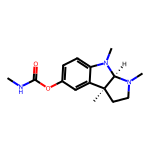

Explanation for instance 0:


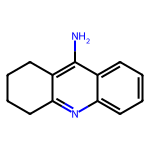

Explanation for instance 1:


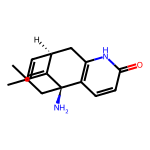

Explanation for instance 2:


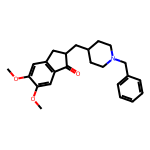

Explanation for instance 3:


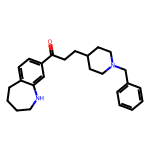

Explanation for instance 4:


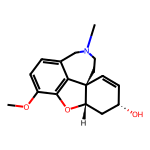

Explanation for instance 5:


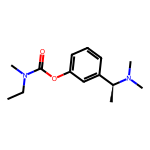

Explanation for instance 6:


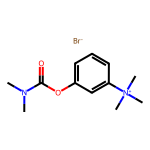

Explanation for instance 7:


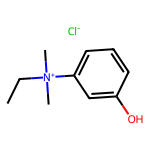

Explanation for instance 8:


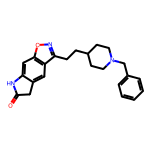

Explanation for instance 9:


In [ ]:
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import Draw
import matplotlib.pyplot as plt
import lime
import lime.lime_tabular


feature_columns = combined_df.loc[:, 'fp_0':]

X = feature_columns.values

# Initialize the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X,
                                                  feature_names=feature_columns.columns,
                                                  class_names=["0", "1"],
                                                  discretize_continuous=True)

# Loop through each compound in the DataFrame and generate explanations
explanations = []
for instance_idx in range(X.shape[0]):
    instance = X[instance_idx]

    # Extract and draw compound structure
    smiles = combined_df.loc[instance_idx, 'Smiles']
    mol = Chem.MolFromSmiles(smiles)
    img = Draw.MolToImage(mol, size=(150, 150))

    explanation = explainer.explain_instance(instance, best_model.predict_proba)
    explanations.append((img, explanation))

# Show the explanations in the notebook
for idx, (img, explanation) in enumerate(explanations):
    display(img)
    print(f"Explanation for instance {idx}:")
    explanation.show_in_notebook()


##Model Interpretation(LIME interpreation and fragment contributions visualization)

The capacity of deep and machine learning models to discern intricate, nonlinear links between inputs and outputs, while impressive, also presents a challenge: these processes often remain opaque to human understanding. In the realm of drug design and discovery,  Explainable AI( XAI) has the potential to significantly enhance our understanding of the intricacies involved in error occurrences, non-linear responses, and seemingly random phenomena. Furthermore, the critical role of explainable AI lies in its ability to elucidate the connection between a drug's structural features and its pharmacological effects, identifying crucial elements for informed drug design and discovery(Jiménez-Luna et al., 2020).

The Extended Circular Fingerprints (ECFP)(Rogers & Hahn, 2010), a topological fingerprint designed specifically for QSAR modeling, in conjunction with Local Interpretable Model-agnostic Explanations (LIME)(Ribeiro et al., 2016), which examines local perturbations to deduce feature importance, will enable us to pinpoint significant fragments within a structure that are crucial for specific predictions(Ramsundar et al., 2019)

The whole method is adopted from the deep chem tutorial, can be found here: [colab notebook](https://colab.research.google.com/github/deepchem/deepchem/blob/master/examples/tutorials/Introduction_to_Model_Interpretability.ipynb)

In [215]:
!pip install lime

In [254]:
feature_names= X_train.columns.tolist()

In [255]:
from lime import lime_tabular
explainer = lime_tabular.LimeTabularExplainer(X_train.values,
                                              feature_names=feature_names,
                                              categorical_features=feature_names,
                                              class_names=['0', '1'],
                                              discretize_continuous=True)

In [256]:
def eval_model(my_model):
    def eval_closure(x):
        predictions = my_model.predict_proba(x)
        return predictions
    return eval_closure
model_fn = eval_model(best_model)

In [257]:
# Define a function that creates an evaluator for a given model.
def evaluate_model(model):
    # Define a closure that takes input data and returns predictions using the provided model.
    def evaluate_closure(input_data):
        predictions = model.predict_proba(input_data)
        return predictions
    # Return the closure that encapsulates the evaluation function.
    return evaluate_closure

# Create an evaluator for the best single model.
best_model_evaluator = evaluate_model(best_model)


In [258]:
best_model_evaluator

<function __main__.evaluate_model.<locals>.evaluate_closure(input_data)>

In [260]:
pip install rdkit

In [261]:
len(test_dataset.X)

816

In [269]:
human_test_with_predictions_high = human_test_with_predictions[human_test_with_predictions['Class_1_Prob'] > 0.7]


In [282]:
human_test_with_predictions_high.to_csv('inhibitor_testHigh.csv', index=False)

In [283]:
import deepchem as dc
dataset_file = 'inhibitor_testHigh.csv'
task = ['target']
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)
loader = dc.data.CSVLoader(tasks=task, feature_field='ids', featurizer=featurizer_func)
test_dataseta = loader.create_dataset(dataset_file)

[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerator
[00:08:34] DEPRECATION WARNING: please use MorganGenerat

In [284]:
transformer = dc.trans.BalancingTransformer(dataset=test_dataseta)
test_dataseta = transformer.transform(test_dataseta)

In [286]:
test_features=scaler.transform(test_dataseta.X)

In [287]:
from rdkit import Chem
import pandas as pd
import deepchem as dc

# Function to extract fragments from a set of SMILES strings
def extract_fragments(smiles_set):
    fragments = []
    for smiles in smiles_set:
        smiles = smiles.strip('{}')
        mol = Chem.MolFromSmiles(smiles)
        if mol:
            fragments.extend(Chem.GetMolFrags(mol, asMols=True))
    return fragments

def generate_circular_fingerprint_dict(molecule, fp_length=1024):
    fingerprint_dict = {}
    featurizer = dc.feat.CircularFingerprint(sparse=True, smiles=True, radius=4, size=fp_length)
    fingerprint_features = featurizer._featurize(molecule)
    for key, value in fingerprint_features.items():
        index = key % fp_length
        if index not in fingerprint_dict:
            fingerprint_dict[index] = set()
        fingerprint_dict[index].add(value['smiles'])
    return fingerprint_dict

positive_ids = list(range(len(test_dataseta.X)))

# Initialize an empty set to store unique SMILES strings
unique_smiles_set = set()

# Initialize an empty list to store the combined data
all_data = []

# Loop over each positive_id
for positive_id in positive_ids:
    # Assuming you have a way to get the molecule from positive_id
    molecule = Chem.MolFromSmiles(test_dataseta.ids[positive_id])
    # Generate circular fingerprints
    fragments_activations = generate_circular_fingerprint_dict(molecule)

    explain = explainer.explain_instance(test_features[positive_id], best_model_evaluator, num_features=100, top_labels=1)

    for label in explain.top_labels:
        fragment_weight = dict(explain.as_map()[label])

        # Iterate through fragments_activations
        for index, smiles_set in fragments_activations.items():
            smiles = list(smiles_set)[0]
            if smiles in unique_smiles_set:
                continue
            unique_smiles_set.add(smiles)
            # Validate the SMILES
            mol = Chem.MolFromSmiles(smiles)
            if fragment_weight.get(index, 0.0) > 0.0:
                all_data.append({
                    'ID': positive_id,
                    'Label': label,
                    'Index': index,
                    'Fragment_SMILES': smiles,
                    'Fragment_Weight': fragment_weight[index]
                })

df_fragment = pd.DataFrame(all_data)

df_fragment

[00:10:16] DEPRECATION WARNING: please use MorganGenerator
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked aromatic
[00:10:19] non-ring atom 0 marked arom

,ID,Label,Index,Fragment_SMILES,Fragment_Weight
0,0,1,64,CCc1nc2ccccc2c(N)c1C,0.051003
1,0,1,659,cc(C)c(N)c(c)c,0.051003
2,0,1,276,cnc(CC)c(c)C,0.058557
3,0,1,831,cnc,0.051003
4,0,1,714,cCC,0.051003
...,...,...,...,...,...
395,244,1,394,c-c(n)cn(C)n,0.002771
396,245,1,352,ccc1c(CC(N)=O)cc(=O)oc1c,0.015744
397,246,1,887,ccc1cc(/N=C/c(c)c)ccc1o,0.065585
398,248,1,326,NCc1ccccc1N,0.005546


The software toolkit for growing fragments into molecules has been adopted from repo by Pat Walters available at (https://github.com/PatWalters/fragment_expansion.git)

fatal: destination path 'fragment_expansion' already exists and is not an empty directory.
/content/fragment_expansion


[00:22:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:42] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1nc2ccccc2c(N)c1C': 1175


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1013


[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] non-ring atom 0 marked aromatic
[00:22:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC': 765


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 582


[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] non-ring atom 0 marked aromatic
[00:22:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:53] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN': 310


[00:22:53] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 282


[00:22:54] non-ring atom 2 marked aromatic
[00:22:54] non-ring atom 0 marked aromatic
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:22:55] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCNCCCCN': 2437


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1904
Number of molecules generated from fragment '[N+][O-]': 0


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 0


[00:23:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNCCCO[N+](=O)[O-]': 359


[00:23:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:07] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 315


[00:23:08] non-ring atom 4 marked aromatic
[00:23:08] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'C=O': 206


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 49


[00:23:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCC': 1927


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1387


[00:23:20] non-ring atom 0 marked aromatic
[00:23:20] non-ring atom 0 marked aromatic
[00:23:20] non-ring atom 0 marked aromatic
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNC1=CC(=O)C=CC1=O': 467


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 53


[00:23:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:24] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCCCC': 1985


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1070


[00:23:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:29] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CO': 706


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 567
Number of molecules generated from fragment 'C=C(C)N': 1


[00:23:33] non-ring atom 0 marked aromatic
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1
Number of molecules generated from fragment 'CC(N)N': 0


[00:23:33] non-ring atom 5 marked aromatic
[00:23:33] non-ring atom 0 marked aromatic
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:33] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 0


[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:35] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC[C@@]1(C)c2cc(OC(N)=O)ccc2N(C)[C@H]1N': 598


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 513


[00:23:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:38] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN1CCOCC1': 198


[00:23:38] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 177


[00:23:39] non-ring atom 1 marked aromatic
[00:23:39] non-ring atom 0 marked aromatic
[00:23:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:43] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCCCN(CC)CC': 2273


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1379


[00:23:51] non-ring atom 5 marked aromatic
[00:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCOCC': 416


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 336


[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:55] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc2c(c1)[C@]1(C)CCN(C)C1C2': 717


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 642


[00:23:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:59] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:59] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:59] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:59] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:23:59] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN1CC[C@@]2(C)c3cc(O)ccc3CC12': 726


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 634


[00:24:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:03] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(CC)CC': 224


[00:24:04] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 172


[00:24:05] non-ring atom 0 marked aromatic
[00:24:05] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'c1ccccc1': 3279


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2727


[00:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC1CCN(C)CC1': 421


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 355


[00:24:29] non-ring atom 0 marked aromatic
[00:24:29] non-ring atom 0 marked aromatic
[00:24:29] non-ring atom 0 marked aromatic
[00:24:29] non-ring atom 0 marked aromatic
[00:24:29] non-ring atom 0 marked aromatic
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:32] WARNING: not removing hydrogen atom with dum

Number of molecules generated from fragment 'CCN1CC[C@@]2(C)c3ccccc3CC12': 2742


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2384


[00:24:47] non-ring atom 4 marked aromatic
[00:24:47] non-ring atom 0 marked aromatic
[00:24:47] non-ring atom 0 marked aromatic
[00:24:47] non-ring atom 0 marked aromatic
[00:24:47] non-ring atom 0 marked aromatic
[00:24:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:48] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNc1cc(C(=O)CC)ccc1CC': 1302


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1148


[00:24:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:24:59] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc(C)cc1': 1625


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1449


[00:25:05] non-ring atom 0 marked aromatic
[00:25:05] non-ring atom 4 marked aromatic
[00:25:05] non-ring atom 0 marked aromatic
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc2c(c1)NCCCC2': 382


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 353


[00:25:08] non-ring atom 8 marked aromatic
[00:25:08] non-ring atom 1 marked aromatic
[00:25:08] non-ring atom 0 marked aromatic
[00:25:08] non-ring atom 0 marked aromatic
[00:25:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:14] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1cc(C)cc(C(=O)CCC(C)C)c1': 1352


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1179


[00:25:19] non-ring atom 0 marked aromatic
[00:25:19] non-ring atom 9 marked aromatic
[00:25:19] non-ring atom 6 marked aromatic
[00:25:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:21] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc2c(c1)C(C)(C)C(N)N2C': 690


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 616


[00:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:25] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'O=C1c2cccc(O)c2C(=O)c2c(O)cccc21': 899


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 798
Number of molecules generated from fragment 'CC(C)=CC(C)C': 48


[00:25:31] non-ring atom 0 marked aromatic
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 43


[00:25:31] non-ring atom 0 marked aromatic
[00:25:31] non-ring atom 0 marked aromatic
[00:25:31] non-ring atom 0 marked aromatic
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1cc[n+](C)cc1': 426


[00:25:32] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 364


[00:25:34] non-ring atom 0 marked aromatic
[00:25:34] non-ring atom 6 marked aromatic
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:34] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCN1CCNCC1': 2267


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1763


[00:25:45] non-ring atom 0 marked aromatic
[00:25:45] non-ring atom 0 marked aromatic
[00:25:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:46] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNCCCCCCN': 717


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 613


[00:25:48] non-ring atom 0 marked aromatic
[00:25:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:25:52] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCNCc1ccccc1': 6566


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 5404


[00:26:22] non-ring atom 6 marked aromatic
[00:26:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:23] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN1C(=O)c2ccccc2C1=O': 1560


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1364


[00:26:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:33] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNc1c(CC)c(C)nc2cc(Cl)ccc12': 741


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 647


[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 13 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 8
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 7 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 3 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] non-ring atom 0 marked aromatic
[00:26:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:41] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNc1ncc(C)cc1C#N': 1305


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1150


[00:26:46] non-ring atom 0 marked aromatic
[00:26:46] non-ring atom 0 marked aromatic
[00:26:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCCSC(=S)N(C)C': 1982


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1329


[00:26:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:26:58] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCOc1ccc2c(C)cc(=O)oc2c1': 626


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 535
Number of molecules generated from fragment 'C=S': 2


[00:27:03] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2


[00:27:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:03] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCSC(=S)N(C)C': 1918


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1486


[00:27:13] non-ring atom 8 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] non-ring atom 10 marked aromatic
[00:27:13] non-ring atom 0 marked aromatic
[00:27:13] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:15] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc(C)c(C(C)=O)c1': 1298


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1174


[00:27:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:21] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'C=C1Cc2ccc(O)cc2C1=O': 772


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 66


[00:27:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:24] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'C=C1Cc2ccc(OC)cc2C1=O': 765


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 66


[00:27:26] non-ring atom 0 marked aromatic
[00:27:26] non-ring atom 0 marked aromatic
[00:27:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:27] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:28] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:29] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1ccc(N)cc1C': 1388


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1225


[00:27:34] non-ring atom 0 marked aromatic
[00:27:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:35] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'O=C1Cc2ccccc2CN1': 2506


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2174


[00:27:45] non-ring atom 0 marked aromatic
[00:27:45] non-ring atom 0 marked aromatic
[00:27:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:27:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(=O)Oc1cccc(C)c1': 2635


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2289


[00:27:59] non-ring atom 0 marked aromatic
[00:27:59] non-ring atom 0 marked aromatic
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCCCCCNC(=O)O': 585


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 509


[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:03] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNCCCCCN(C)C': 326


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 279


[00:28:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCc1ccccn1': 2011


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1782


[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)(C)C': 33


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 27


[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 6 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] non-ring atom 0 marked aromatic
[00:28:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:15] WARNING: not removing hydrogen

Number of molecules generated from fragment 'Cc1cccc(F)c1': 2022


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1773


[00:28:23] non-ring atom 0 marked aromatic
[00:28:23] non-ring atom 0 marked aromatic
[00:28:23] non-ring atom 0 marked aromatic
[00:28:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(=O)C1Cc2cc(O)ccc2S1': 1194


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1045


[00:28:30] non-ring atom 0 marked aromatic
[00:28:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:30] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)CCc1cc[n+](C)cc1': 144


[00:28:31] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 131


[00:28:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:34] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1cc(C)c(SC)cc1OC': 1376


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1237


[00:28:41] non-ring atom 0 marked aromatic
[00:28:41] non-ring atom 0 marked aromatic
[00:28:41] non-ring atom 0 marked aromatic
[00:28:41] non-ring atom 0 marked aromatic
[00:28:41] non-ring atom 0 marked aromatic
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:43] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1C2': 717


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 642


[00:28:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:47] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN1CC[C@@]2(C)c3cc(O)ccc3C[C@@H]12': 726


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 634


[00:28:49] non-ring atom 10 marked aromatic
[00:28:49] non-ring atom 9 marked aromatic
[00:28:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:50] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCOC': 613


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 494


[00:28:53] non-ring atom 0 marked aromatic
[00:28:53] non-ring atom 0 marked aromatic
[00:28:53] non-ring atom 0 marked aromatic
[00:28:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:28:56] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCC(=O)NCCCN': 2340


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1832
Number of molecules generated from fragment 'CC(C)CC(C)C': 54


[00:29:04] non-ring atom 0 marked aromatic
[00:29:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:04] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 47


[00:29:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:09] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC1Cc2cc(O)c(OC)cc2C1': 950


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 823


[00:29:12] non-ring atom 0 marked aromatic
[00:29:12] non-ring atom 0 marked aromatic
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:12] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN1CC[C@@]2(C)c3cc(O)ccc3N(C)[C@H]2O1': 700


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 609


[00:29:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:16] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC[C@@H](C)N(C)S': 234


[00:29:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:17] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 185


[00:29:19] non-ring atom 0 marked aromatic
[00:29:19] non-ring atom 0 marked aromatic
[00:29:19] non-ring atom 0 marked aromatic
[00:29:19] non-ring atom 0 marked aromatic
[00:29:19] non-ring atom 0 marked aromatic
[00:29:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:20] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNc1ccc(Cl)cc1': 377


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 329


[00:29:23] non-ring atom 0 marked aromatic
[00:29:23] non-ring atom 0 marked aromatic
[00:29:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:23] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)c1ccc(N)cc1': 790


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 691


[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] non-ring atom 0 marked aromatic
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:30] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNC(=O)CCN(C)C(C)C': 447


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 391
Number of molecules generated from fragment 'C=C1C2C=CCC1(N)c1ccc(=O)[nH]c1C2': 15


[00:29:32] non-ring atom 0 marked aromatic
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 15


[00:29:32] non-ring atom 0 marked aromatic
[00:29:32] non-ring atom 12 marked aromatic
[00:29:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:35] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1ccccc1N': 3303


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2879


[00:29:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:48] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:48] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:48] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)CCC': 1948


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1442


[00:29:57] non-ring atom 13 marked aromatic
[00:29:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:29:57] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(=O)[C@](C)(C)C': 499


[00:29:58] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 428


[00:30:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCCOCCN': 387


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 334


[00:30:02] non-ring atom 0 marked aromatic
[00:30:02] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:02] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:03] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(=S)NCCO': 761


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 633


[00:30:07] non-ring atom 9 marked aromatic
[00:30:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:07] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCCOCCNC(N)=S': 683


[00:30:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:08] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 627


[00:30:11] non-ring atom 0 marked aromatic
[00:30:11] non-ring atom 0 marked aromatic
[00:30:11] non-ring atom 0 marked aromatic
[00:30:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:15] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCCCOc1ccccc1': 5345


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 4517


[00:30:38] non-ring atom 0 marked aromatic
[00:30:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:40] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNc1c(CC)c(C)nc2ncccc12': 812


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 704


[00:30:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:30:51] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCN(Cc1cccc(O)c1)C(C)C': 3227


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2638


[00:31:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:05] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Sc1ccc(Cl)cc1': 152


[00:31:05] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 131


[00:31:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)(CO)C(N)=O': 200


[00:31:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:07] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 185


[00:31:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:09] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNC(=O)C(C)(C)CO[N+](=O)[O-]': 407


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 353


[00:31:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc2c(c1)CNCCC2': 414


[00:31:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 387


[00:31:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:17] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc(O)cc1C': 1321


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1178


[00:31:23] non-ring atom 4 marked aromatic
[00:31:23] non-ring atom 0 marked aromatic
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:27] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:28] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:29] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1ccc[n+](Cc2ccccc2F)c1': 3902


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 3385


[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:50] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1c[n+]ccc1CC(C)C': 90


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 76


[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:51] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'O=C1CCCc2cc(O)ccc21': 749


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 653


[00:31:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:31:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCCCOC': 2218


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1304
Number of molecules generated from fragment 'c1cc2ccsc2s1': 47


[00:32:09] non-ring atom 6 marked aromatic
[00:32:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:09] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 42


[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:10] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(NC)C(=O)O': 414


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 350


[00:32:13] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:14] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(=O)c1cc2ccsc2s1': 397


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 339


[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 7 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] non-ring atom 0 marked aromatic
[00:32:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:17] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNCC(N)=O': 588


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 532


[00:32:20] non-ring atom 0 marked aromatic
[00:32:20] non-ring atom 0 marked aromatic
[00:32:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:23] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCN(CC)C(CC)CC': 2368


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1857


[00:32:35] non-ring atom 2 marked aromatic
[00:32:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:36] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC=C(NCCCN(C)C)C(C)=O': 256


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 224


[00:32:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:32:40] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNC(=O)c1ccccc1': 5216


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 4412


[00:33:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:07] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:08] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCc1c[nH]c2ccccc12': 2604


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1998


[00:33:21] non-ring atom 0 marked aromatic
[00:33:21] non-ring atom 0 marked aromatic
[00:33:21] non-ring atom 0 marked aromatic
[00:33:21] non-ring atom 9 marked aromatic
[00:33:21] non-ring atom 0 marked aromatic
[00:33:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:24] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1cc(C)n(-c2ccccc2)n1': 4824


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 4082


[00:33:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:56] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:33:56] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCC(=O)c1ccc(N)c(CC)c1': 2805


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2269


[00:34:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(=O)c1ccc2c(c1)CCN2C': 645


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 574


[00:34:16] non-ring atom 0 marked aromatic
[00:34:16] non-ring atom 0 marked aromatic
[00:34:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:18] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:18] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCOc1ccc(C(N)=O)cc1': 1353


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1198


[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:23] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNCc1ccc(CN(C)C)o1': 278


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 236


[00:34:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:25] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN=C(C(C)C)N(C)C': 112


[00:34:25] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 107


[00:34:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN(C)Cc1ccc(CN)o1': 435


[00:34:27] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:27] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 404


[00:34:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:32] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN(CC)Cc1ccc(CN)o1': 666


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 608


[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:35] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)(C)[C@@H]([C@H](C)NC)[C@@H](C)O': 167


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 150


[00:34:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:34:41] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCCc1ccccc1': 5054


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 4272


[00:34:59] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'OCCCN1CCCCC1': 655


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 550


[00:35:03] non-ring atom 0 marked aromatic
[00:35:03] non-ring atom 0 marked aromatic
[00:35:03] non-ring atom 0 marked aromatic
[00:35:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:04] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'C[C@@H](c1cccc(O)c1)N(C)C': 1264


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1114


[00:35:10] non-ring atom 0 marked aromatic
[00:35:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'O=C1CCc2cccc3c2N1CCC3': 526


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 470


[00:35:14] non-ring atom 0 marked aromatic
[00:35:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:15] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:16] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCc1cccc(Cl)c1': 1388


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1247


[00:35:21] non-ring atom 0 marked aromatic
[00:35:21] non-ring atom 0 marked aromatic
[00:35:21] non-ring atom 0 marked aromatic
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:23] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:23] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN1CC[C@@]2(C)c3ccccc3C[C@@H]12': 2742


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2384


[00:35:37] non-ring atom 0 marked aromatic
[00:35:37] non-ring atom 0 marked aromatic
[00:35:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:38] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1ccc([N+](=O)[O-])cc1C(N)=O': 1002


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 921


[00:35:44] non-ring atom 0 marked aromatic
[00:35:44] non-ring atom 2 marked aromatic
[00:35:44] non-ring atom 0 marked aromatic
[00:35:44] non-ring atom 14 marked aromatic
[00:35:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:45] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=C)C(=O)OC': 369


[00:35:45] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 25


[00:35:46] non-ring atom 5 marked aromatic
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:47] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC[C@H](O)[C@H](C)[C@H](CC)C(=C)C': 506


[00:35:48] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:48] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 358


[00:35:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:50] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(C)=CC': 664


[00:35:50] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 583


[00:35:52] non-ring atom 0 marked aromatic
[00:35:52] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[00:35:52] Can't kekulize mol.  Unkekulized atoms: 2 5 7
[00:35:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:35:55] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNc1ccc(C(C)=O)cc1CC': 1062


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 945


[00:36:00] non-ring atom 0 marked aromatic
[00:36:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNCCCNC': 223


[00:36:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:00] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 188


[00:36:01] non-ring atom 0 marked aromatic
[00:36:01] non-ring atom 0 marked aromatic
[00:36:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:05] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc(C)cc1C': 2040


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1815


[00:36:13] non-ring atom 0 marked aromatic
[00:36:13] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:13] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:14] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:14] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'C=Cc1ccc2oc(C)cc(=O)c2c1': 484


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 434


[00:36:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:20] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1ccc2oc(C(N)=O)cc(=O)c2c1': 1764


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1574


[00:36:30] non-ring atom 0 marked aromatic
[00:36:30] non-ring atom 0 marked aromatic
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:31] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Oc1cccc2[nH]c3ccccc3c12': 805


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 698


[00:36:34] non-ring atom 0 marked aromatic
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:34] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:36] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:36] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COc1ccc2c(c1)C(C)(C)[C@@H](N)N2C': 690


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 616


[00:36:39] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:40] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:40] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN1CCN(CC)C1=O': 272


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 245


[00:36:42] non-ring atom 0 marked aromatic
[00:36:42] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:42] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN(C)CCCN(C)C': 57


[00:36:42] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 52


[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:43] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN1CCN(CCCN)CC1': 604


[00:36:44] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 491


[00:36:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:46] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:47] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCN1CCN(CC)CC1': 2169


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1675


[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:36:58] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COC(=O)C1CCCN1C(C)=O': 476


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 405


[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:02] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(=O)C(CC(C)C)NC(C)=O': 764


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 678


[00:37:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:05] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN(C(C)=O)C(C)C': 429


[00:37:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 391


[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(C(=O)NC(C)C)C(C)C': 162


[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:09] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 153
Number of molecules generated from fragment 'CC(C)C(C)N': 38


[00:37:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:10] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:11] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 36


[00:37:11] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:12] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(N)Cc1ccc2ccccc2c1': 1192


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1029


[00:37:16] non-ring atom 5 marked aromatic
[00:37:16] non-ring atom 0 marked aromatic
[00:37:16] non-ring atom 0 marked aromatic
[00:37:16] non-ring atom 0 marked aromatic
[00:37:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:17] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNC(=O)CCOCC': 825


[00:37:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:17] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 691
Number of molecules generated from fragment 'C=NC(=O)C(=C)S': 20


[00:37:20] non-ring atom 0 marked aromatic
[00:37:20] non-ring atom 0 marked aromatic
[00:37:20] non-ring atom 0 marked aromatic
[00:37:20] non-ring atom 0 marked aromatic
[00:37:20] non-ring atom 0 marked aromatic
[00:37:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:21] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 12


[00:37:21] non-ring atom 0 marked aromatic
[00:37:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:22] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1cc[n+](CC)cc1': 428


[00:37:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:22] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:22] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 365


[00:37:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC(=O)CN1CCN(C)CC1': 562


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 484


[00:37:29] non-ring atom 0 marked aromatic
[00:37:29] non-ring atom 0 marked aromatic
[00:37:29] non-ring atom 0 marked aromatic
[00:37:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:29] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:29] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN(CC)CC(=O)NC': 643


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 561


[00:37:32] non-ring atom 0 marked aromatic
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment '[N+]c1cc([N+](=O)[O-])c(NCCS)cc1NN': 64


[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:32] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 38


[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:33] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCCCCCCS': 2080


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 176


[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] non-ring atom 6 marked aromatic
[00:37:41] non-ring atom 0 marked aromatic
[00:37:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:41] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:42] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:42] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)Nc1ccc2ncn(C)c(=O)c2c1': 463


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 432


[00:37:44] non-ring atom 0 marked aromatic
[00:37:44] Can't kekulize mol.  Unkekulized atoms: 4
[00:37:44] non-ring atom 0 marked aromatic
[00:37:44] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:44] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:44] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:44] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:45] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:45] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cn1cnc2ccc(N)cc2c1=O': 748


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 661


[00:37:48] non-ring atom 0 marked aromatic
[00:37:48] non-ring atom 0 marked aromatic
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:49] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC1CCC[N+](C)(CCO)CC1': 430


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 348


[00:37:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:51] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'COCC[N+]': 215


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 173


[00:37:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:54] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:54] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN(CC)CC1CC1': 288


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 261


[00:37:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:55] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:57] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:57] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC1CCN(CC(C)C)CC1': 273


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 221


[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:37:58] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(C)CN1CCCCC1': 290


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 257


[00:38:00] non-ring atom 0 marked aromatic
[00:38:00] non-ring atom 0 marked aromatic
[00:38:00] non-ring atom 0 marked aromatic
[00:38:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:00] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:01] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:01] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCC(CC)CN': 342


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 281


[00:38:02] non-ring atom 0 marked aromatic
[00:38:02] non-ring atom 0 marked aromatic
[00:38:02] non-ring atom 0 marked aromatic
[00:38:02] non-ring atom 0 marked aromatic
[00:38:02] non-ring atom 0 marked aromatic
[00:38:02] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:02] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:06] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:06] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCc1ccc(O)c(OC)c1': 2749


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2227


[00:38:17] non-ring atom 6 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 12 marked aromatic
[00:38:17] non-ring atom 3 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] non-ring atom 0 marked aromatic
[00:38:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:17] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:18] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:18] WARNING: not removing hydrogen ato

Number of molecules generated from fragment 'CCn1cc(-c2ccnc(N)c2)nn1': 349


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 317


[00:38:19] non-ring atom 0 marked aromatic
[00:38:19] non-ring atom 0 marked aromatic
[00:38:19] non-ring atom 0 marked aromatic
[00:38:19] non-ring atom 0 marked aromatic
[00:38:19] non-ring atom 0 marked aromatic
[00:38:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:21] WARNING: not removing hydrogen atom with dummy atom neighbors
[00:38:21] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'NCc1ccccc1N': 3334


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2937


[00:38:35] non-ring atom 0 marked aromatic


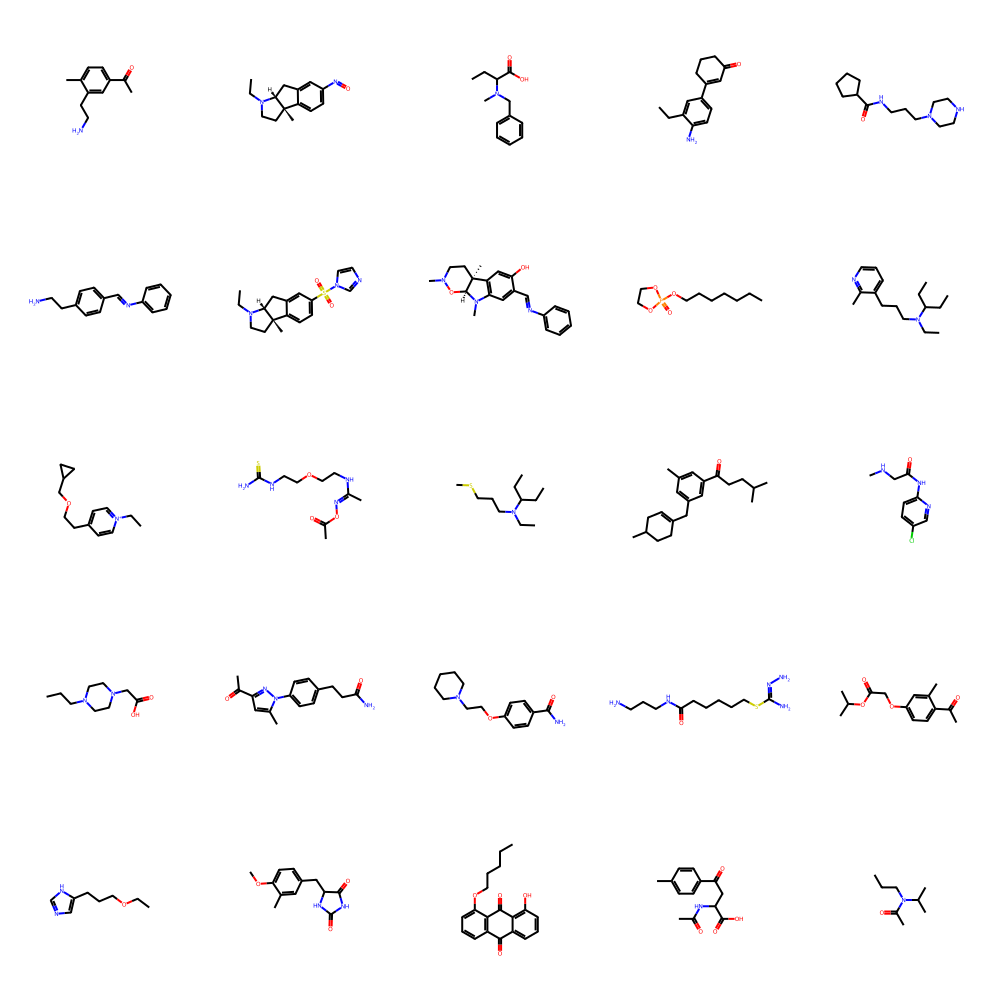

In [289]:
!git clone https://github.com/PatWalters/fragment_expansion.git
%cd /content/fragment_expansion
!pip install crem
!pip install rdkit
%load /content/fragment_expansion/reos.py

from rdkit import Chem
from crem.crem import grow_mol
from rdkit.Chem.Scaffolds.MurckoScaffold import GetScaffoldForMol
from rdkit.Chem import AllChem
from rdkit.Chem.Draw import MolsToGridImage
from reos import REOS
import random
from rdkit.Chem.rdmolops import RemoveHs
import pandas as pd

# List of fragment SMILES strings
frag_smi_list = df_fragment['Fragment_SMILES']

expanded_mol_list = []
filtered_mol_list = []

# Iterate over each fragment SMILES
for frag_smi in frag_smi_list:
    # Convert fragment SMILES to RDKit molecule
    frag_mol = Chem.MolFromSmiles(frag_smi)

    if frag_mol is None:
        continue

    # Compute 2D coordinates for visualization
    AllChem.Compute2DCoords(frag_mol)

    # Specify the CReM database file
    crem_db_file = '/content/drive/MyDrive/replacements02_sc2.5.db'

    # Use the most general form of the grow_mol function
    grow_list = list(grow_mol(frag_mol, db_name=crem_db_file, max_atoms=8, return_mol=True))
    mol_list = [RemoveHs(x[1]) for x in grow_list]
    _ = [AllChem.GenerateDepictionMatching2DStructure(m, frag_mol) for m in mol_list]

    print(f"Number of molecules generated from fragment '{frag_smi}': {len(mol_list)}")

    # Use REOS class to filter out undesirable molecules
    reos = REOS("bms_filters.csv")
    filtered_mols = [x for x in mol_list if reos.eval_mol(x)]
    print(f"Number of filtered molecules: {len(filtered_mols)}")

    # Append to overall lists
    expanded_mol_list.extend(mol_list)
    filtered_mol_list.extend(filtered_mols)

# Display a sample of the generated and filtered molecules
random.shuffle(filtered_mol_list)
MolsToGridImage(filtered_mol_list[:25], molsPerRow=5)


In [293]:
from rdkit import Chem

generated_compoundSmiles = []

for mol in filtered_mol_list:
    try:
        smiles = Chem.MolToSmiles(mol)
        generated_compoundSmiles.append(smiles)
    except Chem.rdchem.AtomValenceException:
        print(f"Skipping molecule with invalid valence: {mol}")
    except Chem.rdchem.KekulizeException:
        print(f"Skipping molecule with kekulization issues: {mol}")
    except Chem.rdchem.MolSanitizeException:
        print(f"Skipping molecule with sanitization issues: {mol}")


In [294]:
generated_compoundSmiles=pd.DataFrame(generated_compoundSmiles)

In [296]:
generated_compoundSmiles.to_csv('inhibitor_fragment.csv', index=False)

In [306]:
dataset_file = 'inhibitor_fragment.csv'
task = []
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)

loader = dc.data.CSVLoader(tasks=task, feature_field='0', featurizer=featurizer_func)
fragment_dataset = loader.create_dataset(dataset_file)

Streaming output truncated to the last 5000 lines.
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:54:23] DEPRECATION WARNING: please use MorganGenerator
[00:5

In [309]:
X = scaler.fit_transform(fragment_dataset.X)
# Get predicted probabilities for each class
y_probs = best_model.predict_proba(X)

In [314]:
y_prob_negative = y_probs[:, 0]  # Probability for the negative class
y_prob_positive = y_probs[:, 1]  # Probability for the positive class

In [315]:
y_prob_positive

array([0.11666667, 0.31666667, 0.20666667, ..., 0.36888889, 0.16666667,
       0.29666667])

In [316]:
df_fragmentDataset = pd.DataFrame({'Smiles': fragment_dataset.ids, 'Postive Prediction': y_probs[:, 1]})


In [318]:
filtered_dfa = df_fragmentDataset[df_fragmentDataset['Postive Prediction'] > 0.8]

<ipython-input-321-d67cd6d939a3>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



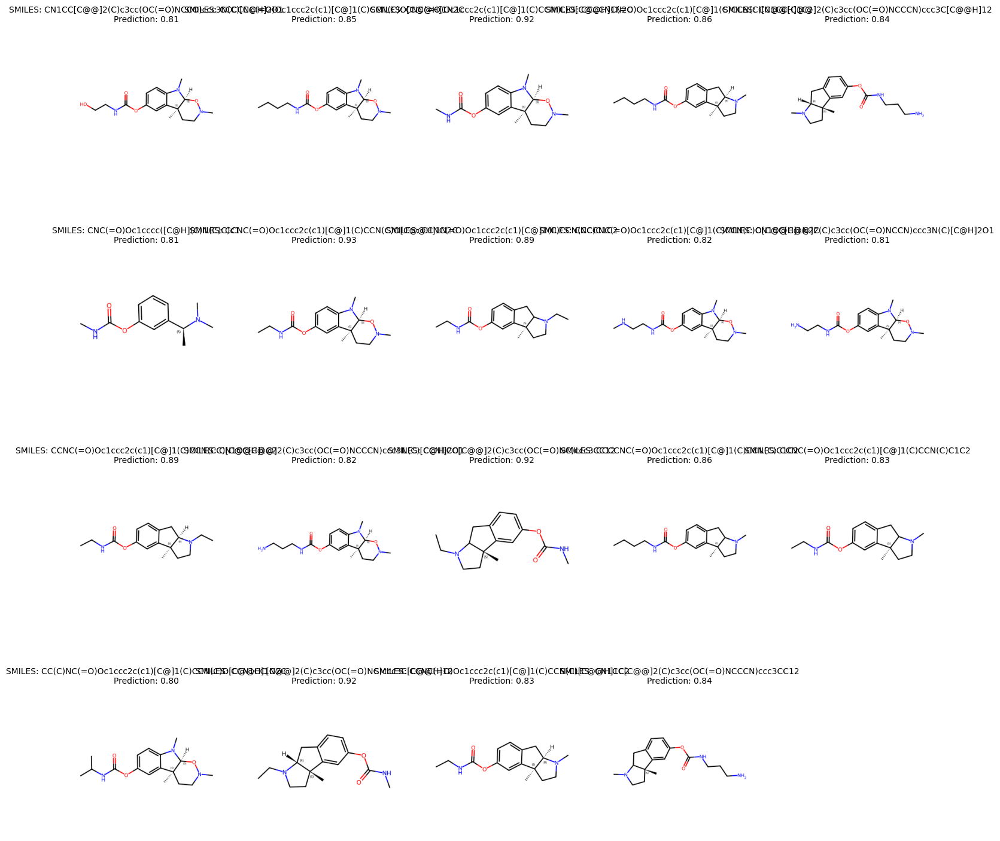

In [321]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
import matplotlib.pyplot as plt
import io
from PIL import Image


# Convert SMILES to RDKit Mol objects
filtered_dfa['Mol'] = filtered_dfa['Smiles'].apply(Chem.MolFromSmiles)

# Function to create a high-quality image of a molecule
def mol_to_image(mol, size=(300, 300)):
    d2d = rdMolDraw2D.MolDraw2DCairo(size[0], size[1])
    d2d.drawOptions().addAtomIndices = False
    d2d.drawOptions().addStereoAnnotation = True
    d2d.DrawMolecule(mol)
    d2d.FinishDrawing()
    img_data = d2d.GetDrawingText()
    return Image.open(io.BytesIO(img_data))

# Draw molecular structures
images = [mol_to_image(mol) for mol in filtered_dfa['Mol']]

# Set up plotting parameters
num_images = len(images)
num_cols = 5  # Number of molecules per row
fig_width = 15  # Total figure width in inches
row_height = 3.5  # Height per row in inches
num_rows = (num_images + num_cols - 1) // num_cols  # Calculate number of rows needed

# Create the figure and axes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(fig_width, row_height * num_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each molecule
for i, (img, smiles, pred) in enumerate(zip(images, filtered_dfa['Smiles'], filtered_dfa['Postive Prediction'])):
    ax = axes[i]
    ax.imshow(img)
    ax.set_title(f'SMILES: {smiles}\nPrediction: {pred:.2f}', fontsize=10)
    ax.axis('off')

# Remove any unused subplots
for j in range(num_images, num_rows * num_cols):
    axes[j].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.subplots_adjust(hspace=0.5)  # Adjust vertical spacing between rows
plt.show()


## Model Interpretation with LIME for 10 selected known acetylcholinesterase inhibitors






In [322]:
!pip install lime

In [323]:
# List of commonly known acetylcholinesterase inhibitor
chembl_ids = ['CHEMBL94', 'CHEMBL54126', 'CHEMBL636', 'CHEMBL113', 'CHEMBL659', 'CHEMBL95', 'CHEMBL1128', 'CHEMBL1255901','CHEMBL502', 'CHEMBL75013', 'CHEMBL359570', 'CHEMBL75013']

# Select rows where the 'chembl_id' column is in the list of ChEMBL IDs
combined_df = df_withFeatures[df_withFeatures['Molecule ChEMBL ID'].isin(chembl_ids)]

In [325]:
combined_df.reset_index(drop=True, inplace=True)

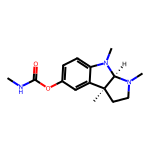

Explanation for instance 0:


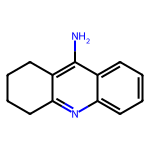

Explanation for instance 1:


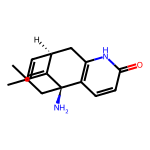

Explanation for instance 2:


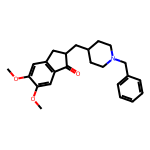

Explanation for instance 3:


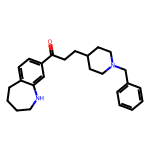

Explanation for instance 4:


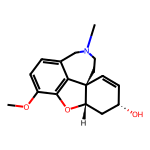

Explanation for instance 5:


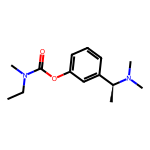

Explanation for instance 6:


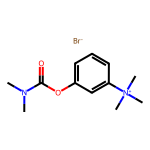

Explanation for instance 7:


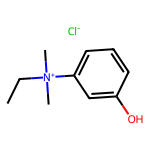

Explanation for instance 8:


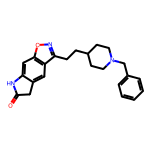

Explanation for instance 9:


In [326]:
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import Draw
import matplotlib.pyplot as plt
import lime
import lime.lime_tabular

# Extract features
feature_columns = combined_df.loc[:, 'fp_0':]

# Convert to numpy array if necessary
X = feature_columns.values

# Initialize the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X,
                                                  feature_names=feature_columns.columns,
                                                  class_names=["0", "1"],
                                                  discretize_continuous=True)

# Loop through each compound in the DataFrame and generate explanations
explanations = []
for instance_idx in range(X.shape[0]):
    instance = X[instance_idx]

    # Extract and draw compound structure
    smiles = combined_df.loc[instance_idx, 'Smiles']
    mol = Chem.MolFromSmiles(smiles)
    img = Draw.MolToImage(mol, size=(150, 150))

    explanation = explainer.explain_instance(instance, best_model.predict_proba)
    explanations.append((img, explanation))

# Show the explanations in the notebook
for idx, (img, explanation) in enumerate(explanations):
    display(img)
    print(f"Explanation for instance {idx}:")
    explanation.show_in_notebook()


## Model Interpretation with SHAP and for 10 selected compounds

The method of model interpretation with SHAP is adopted from  (https://colab.research.google.com/github/ing-bank/probatus/blob/master/docs/tutorials/nb_shap_model_interpreter.ipynb)

In [327]:
! pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 10.9 MB/s eta 0:00:00


In [328]:
import shap

In [329]:
!pip install probatus

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.2/54.2 kB 1.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 2.7 MB/s eta 0:00:00


In [330]:
best_model

RandomForestClassifier(n_estimators=300)

In [331]:
from probatus.interpret import ShapModelInterpreter
shap_interpreter = ShapModelInterpreter(best_model)
feature_importance = shap_interpreter.fit_compute(X_train, X_test, y_train,y_test, approximate=False)
feature_importance

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names

100%|===================| 1629/1632 [01:54<00:00]       

,mean_abs_shap_value_test,mean_abs_shap_value_train,mean_shap_value_test,mean_shap_value_train
fp_954,0.031589,0.024661,-0.005476,0.005324
fp_276,0.020827,0.015750,-0.002819,0.004902
fp_304,0.014177,0.012695,0.000493,0.002533
fp_924,0.012581,0.009144,-0.002639,0.002460
fp_784,0.011752,0.012101,0.001836,0.001138
...,...,...,...,...
fp_977,0.000000,0.000000,0.000000,0.000000
fp_978,0.000000,0.000000,0.000000,0.000000
fp_979,0.000000,0.000000,0.000000,0.000000
fp_980,0.000000,0.000000,0.000000,0.000000


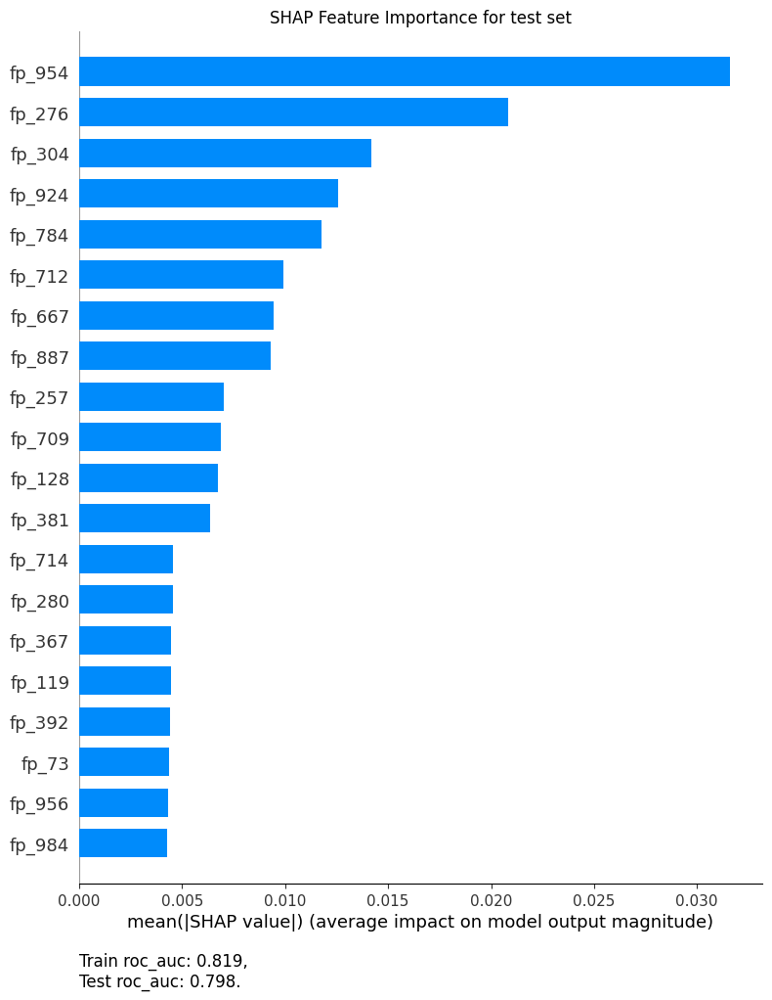

In [332]:
ax = shap_interpreter.plot("importance")

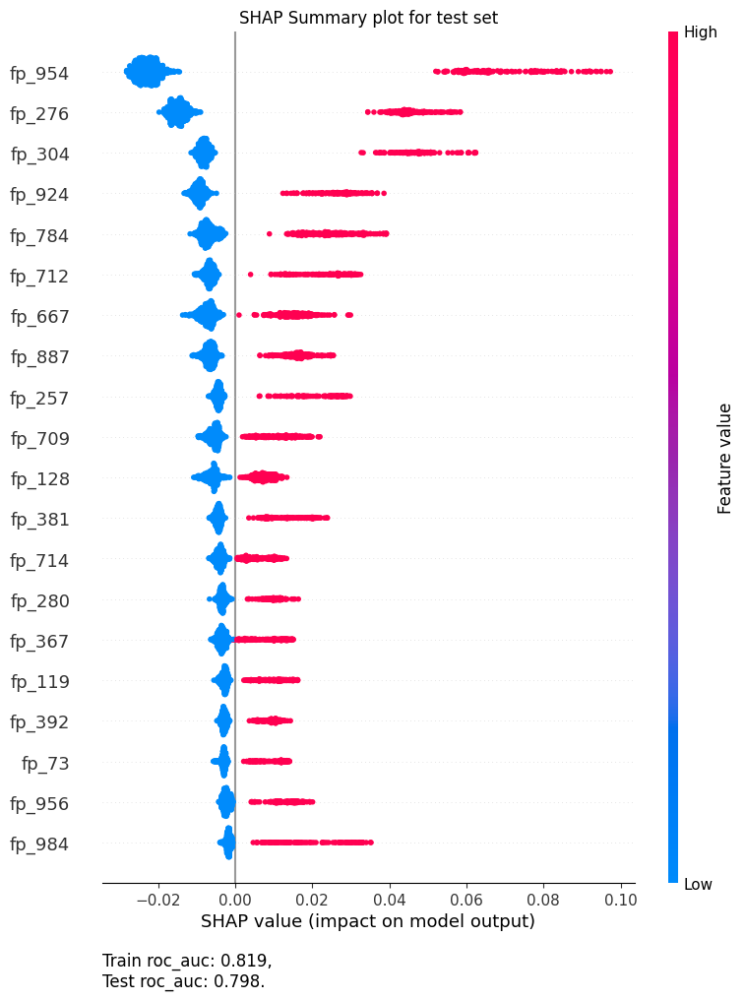

In [333]:
ax = shap_interpreter.plot("summary")

### SHAP interpretation for 10 selected compounds

In [334]:
combined_df

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fp_1014,fp_1015,fp_1016,fp_1017,fp_1018,fp_1019,fp_1020,fp_1021,fp_1022,fp_1023
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,CHEMBL95,Nc1c2c(nc3ccccc13)CCCC2,45.10,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e886d0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.127724,0.704160,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,CHEMBL1255901,C/C=C1\[C@H]2C=C(C)C[C@@]1(N)c1ccc(=O)[nH]c1C2,5.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e889e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.862149,-0.194694,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,CHEMBL502,COc1cc2c(cc1OC)C(=O)C(CC1CCN(Cc3ccccc3)CC1)C2,10.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e89380>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.143176,2.991514,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,CHEMBL75013,O=C(CCC1CCN(Cc2ccccc2)CC1)c1ccc2c(c1)NCCCC2,194.98,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8a7a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.595382,3.203060,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5,CHEMBL659,COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2,2090.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e84660>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.604482,-0.005219,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
6,CHEMBL636,CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1,3030.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8fd10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.223036,-1.661954,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,CHEMBL54126,CN(C)C(=O)Oc1cccc([N+](C)(C)C)c1.[Br-],31.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd93d59a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.028787,-1.489257,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,CHEMBL1128,CC[N+](C)(C)c1cccc(O)c1.[Cl-],5000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd94033e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.511788,-0.445985,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,CHEMBL359570,O=C1Cc2cc3c(CCC4CCN(Cc5ccccc5)CC4)noc3cc2N1,0.33,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e74b30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.638255,3.542295,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [335]:
from probatus.interpret import ShapModelInterpreter
shap_interpreter = ShapModelInterpreter(best_model)
feature_importance = shap_interpreter.fit_compute(X_train, combined_df.loc[:, 'fp_0':], y_train,combined_df['classLabel'], approximate=False)
feature_importance

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names

100%|===================| 6519/6522 [07:40<00:00]       

,mean_abs_shap_value_test,mean_abs_shap_value_train,mean_shap_value_test,mean_shap_value_train
fp_276,0.012298,0.019844,0.012298,-0.002313
fp_257,0.010560,0.006993,-0.005338,-0.001408
fp_954,0.010367,0.028030,0.010367,-0.000610
fp_956,0.010052,0.004493,-0.010052,-0.000184
fp_984,0.009006,0.004746,0.009006,0.000366
...,...,...,...,...
fp_968,0.000000,0.000000,0.000000,0.000000
fp_969,0.000000,0.000000,0.000000,0.000000
fp_970,0.000000,0.000000,0.000000,0.000000
fp_971,0.000000,0.000000,0.000000,0.000000


In [336]:
sample_index = combined_df.loc[:, 'fp_0':].index.tolist()


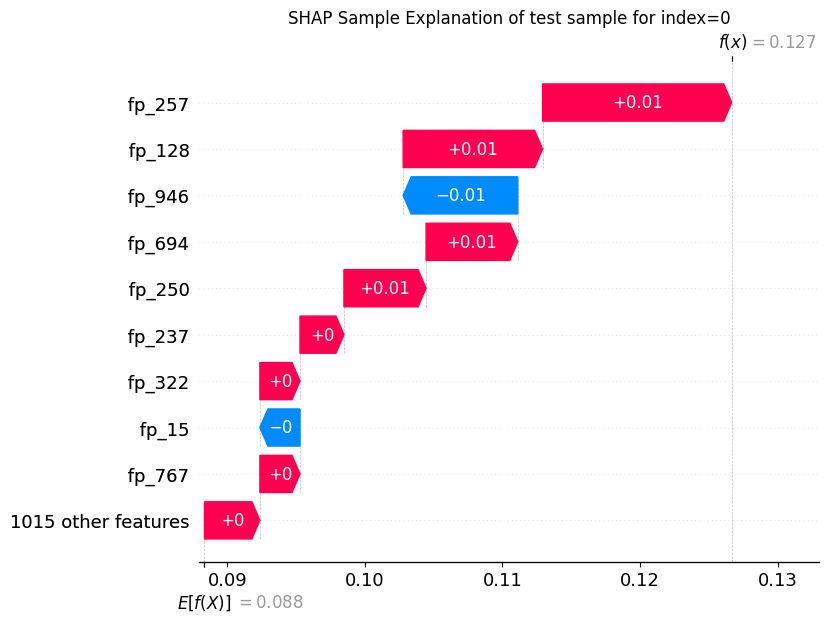

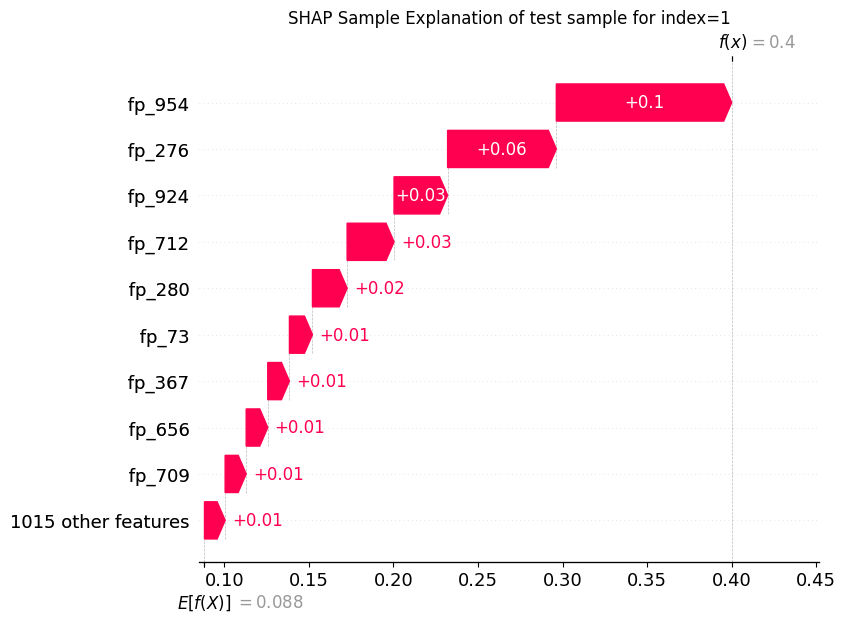

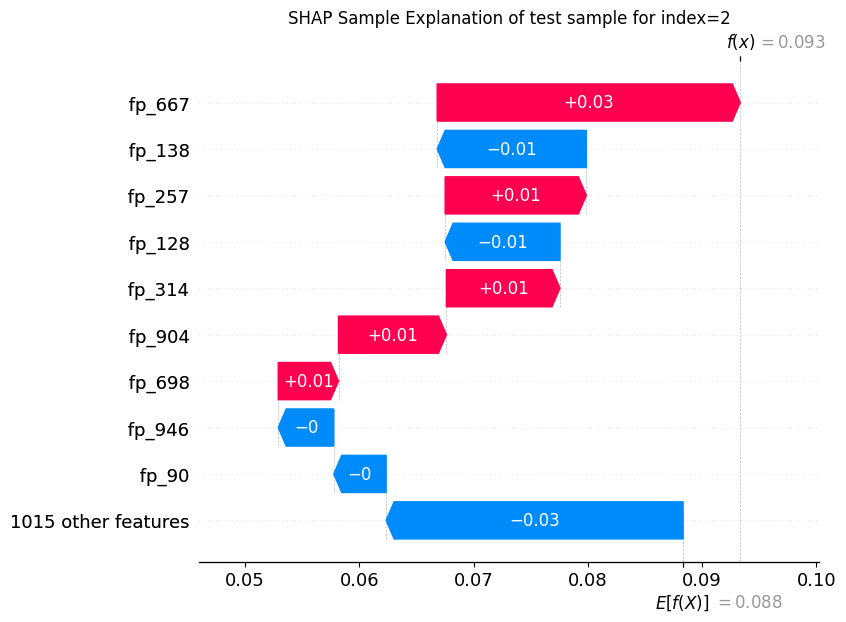

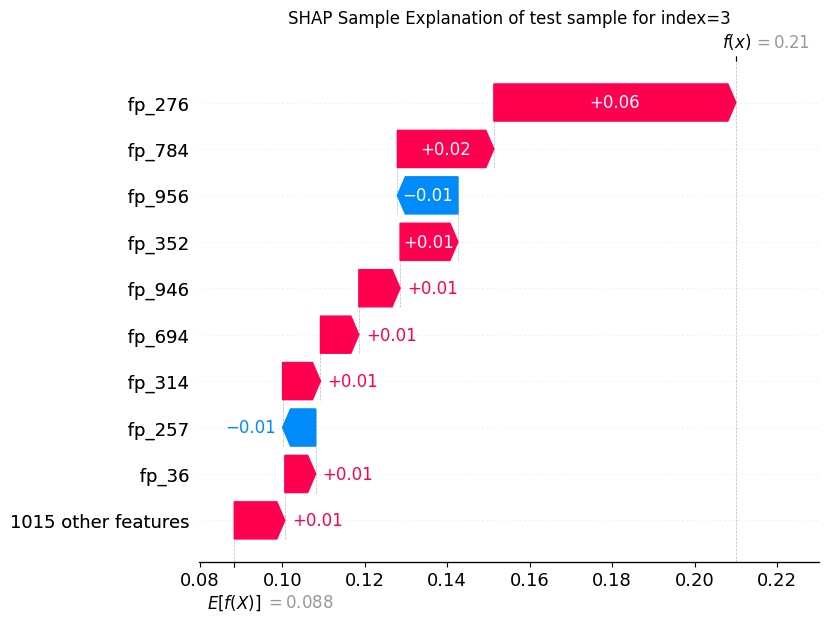

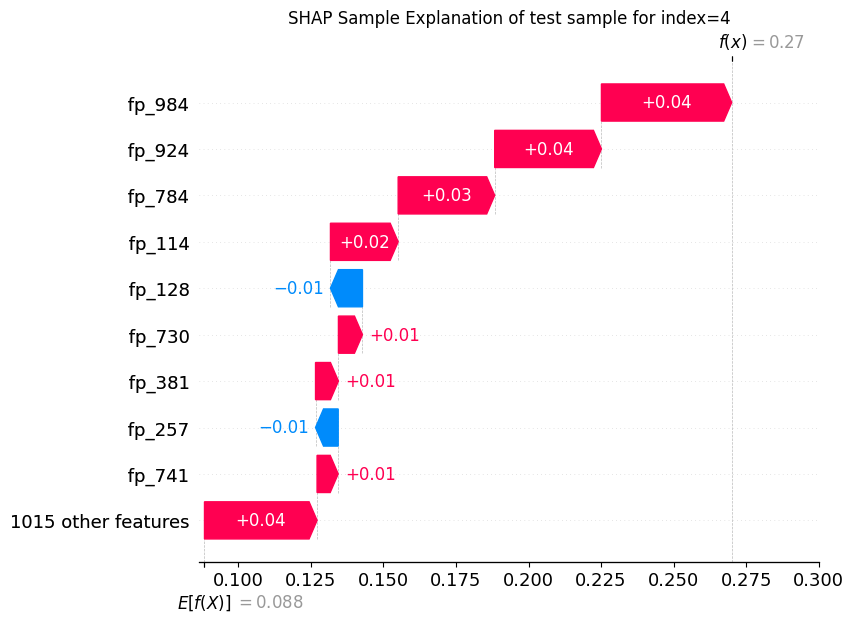

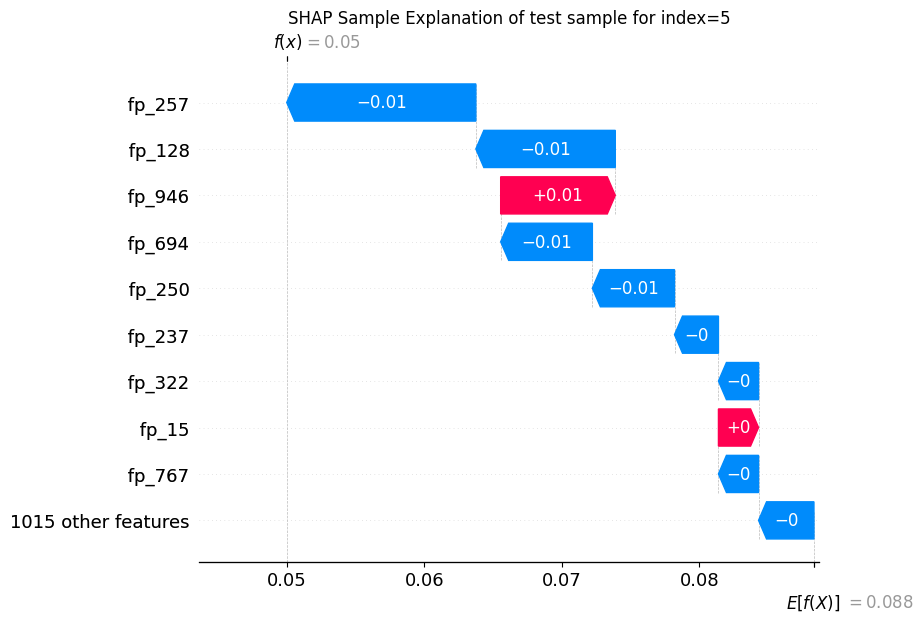

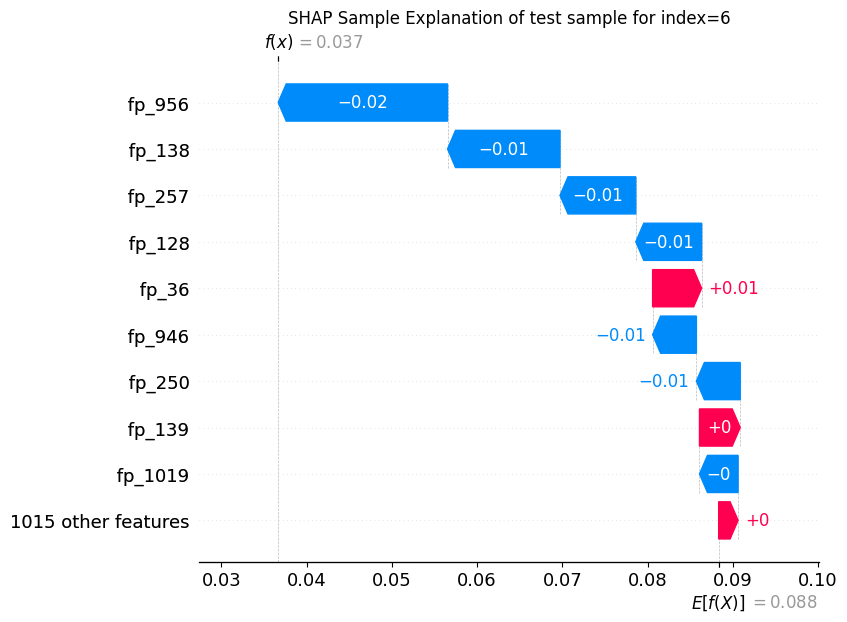

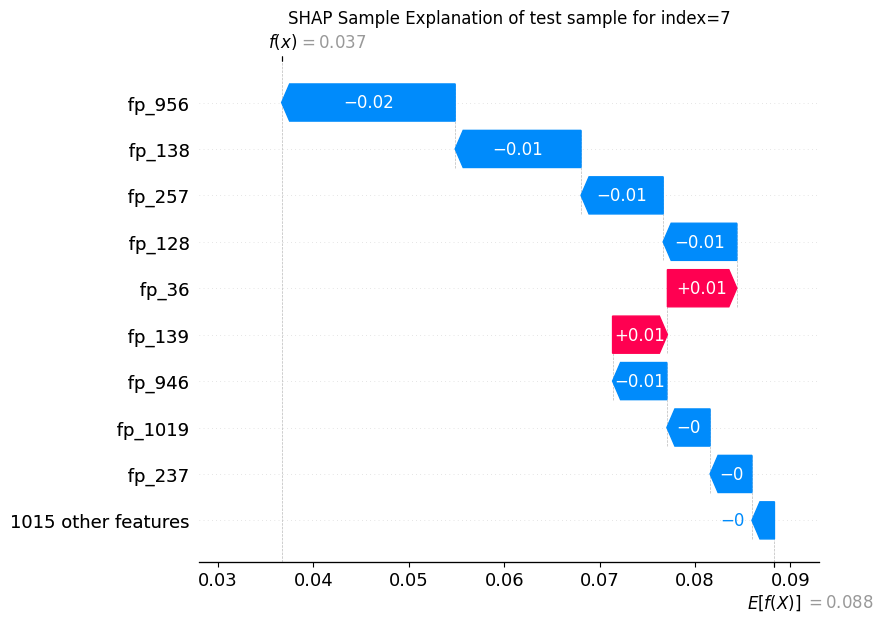

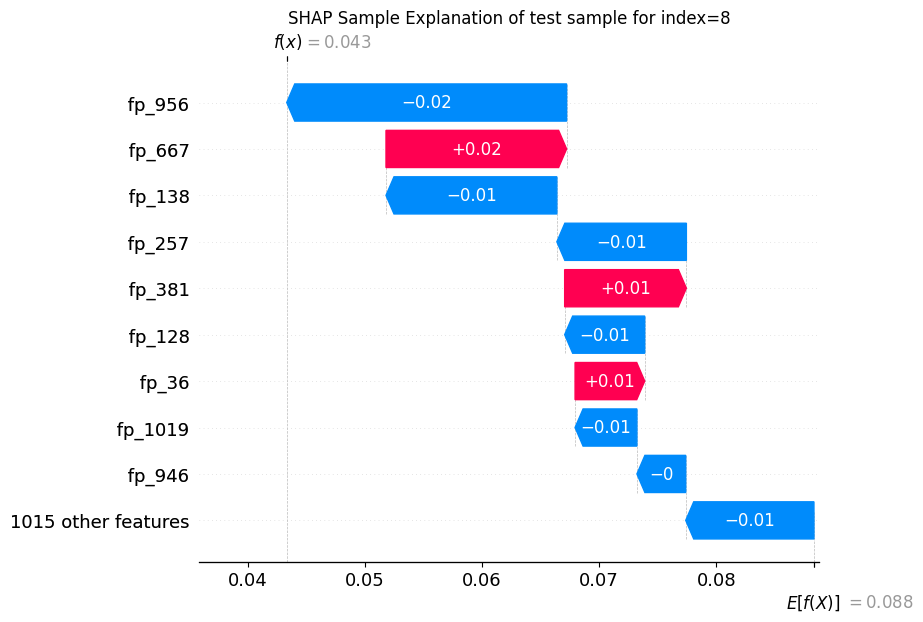

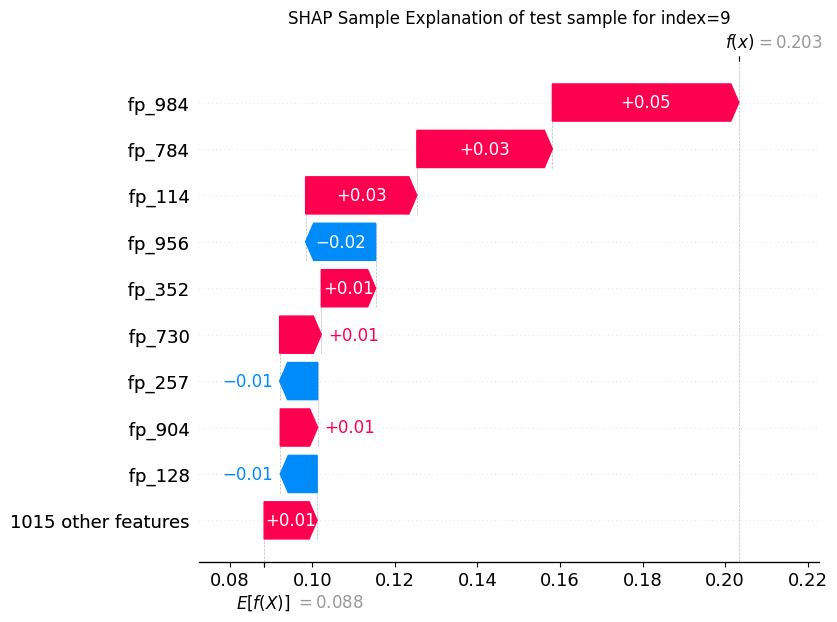

In [338]:
ax4 = shap_interpreter.plot('sample', samples_index=sample_index)


## Generation of potential AChE inhibtiors form 10 selected compounds

In [346]:
combined_df.to_csv('inhibitor_tenCompounds.csv', index=False)

In [347]:
import deepchem as dc
dataset_file = 'inhibitor_tenCompounds.csv'
task = ['classLabel']
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)
loader = dc.data.CSVLoader(tasks=task, feature_field='cleanedMol', featurizer=featurizer_func)
test_datasetb = loader.create_dataset(dataset_file)

[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator
[01:20:45] DEPRECATION WARNING: please use MorganGenerator


In [353]:
transformer = dc.trans.BalancingTransformer(dataset=test_datasetb)
test_datasetb = transformer.transform(test_datasetb)

In [354]:
test_features_10=scaler.transform(test_datasetb.X)

In [355]:
len(test_features_10)

10

In [356]:
from rdkit import Chem
import pandas as pd
import deepchem as dc

# Function to extract fragments from a set of SMILES strings
def extract_fragments(smiles_set):
    fragments = []
    for smiles in smiles_set:
        smiles = smiles.strip('{}')
        mol = Chem.MolFromSmiles(smiles)
        if mol:
            fragments.extend(Chem.GetMolFrags(mol, asMols=True))
    return fragments

def generate_circular_fingerprint_dict(molecule, fp_length=1024):
    fingerprint_dict = {}
    featurizer = dc.feat.CircularFingerprint(sparse=True, smiles=True, radius=4, size=fp_length)
    fingerprint_features = featurizer._featurize(molecule)
    for key, value in fingerprint_features.items():
        index = key % fp_length
        if index not in fingerprint_dict:
            fingerprint_dict[index] = set()
        fingerprint_dict[index].add(value['smiles'])
    return fingerprint_dict

positive_ids = list(range(len(test_datasetb.X)))
# Initialize an empty set to store unique SMILES strings
unique_smiles_set = set()

# Initialize an empty list to store the combined data
all_data = []

# Loop over each positive_id
for positive_id in positive_ids:
    molecule = Chem.MolFromSmiles(test_datasetb.ids[positive_id])

    # Generate circular fingerprints
    fragments_activations = generate_circular_fingerprint_dict(molecule)

    explain = explainer.explain_instance(test_features_10[positive_id], best_model_evaluator, num_features=100, top_labels=1)

    for label in explain.top_labels:
        fragment_weight = dict(explain.as_map()[label])

        # Iterate through fragments_activations
        for index, smiles_set in fragments_activations.items():
            smiles = list(smiles_set)[0]
            if smiles in unique_smiles_set:
                continue
            unique_smiles_set.add(smiles)

            # Validate the SMILES
            mol = Chem.MolFromSmiles(smiles)
            if fragment_weight.get(index, 0.0) > 0.0:
                all_data.append({
                    'ID': positive_id,
                    'Label': label,
                    'Index': index,
                    'Fragment_SMILES': smiles,
                    'Fragment_Weight': fragment_weight[index]
                })

# Create a DataFrame from all_data
df_fragment_10 = pd.DataFrame(all_data)

df_fragment_10

[01:21:52] DEPRECATION WARNING: please use MorganGenerator
[01:21:58] non-ring atom 3 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 1 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 6 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 2 marked aromatic
[01:21:58] non-ring atom 1 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 1 marked aromatic
[01:21:58] non-ring atom 5 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 0 marked aromatic
[01:21:58] non-ring atom 2 marked aromatic
[01:21:58] non-ring atom 0 marked arom

,ID,Label,Index,Fragment_SMILES,Fragment_Weight
0,0,0,36,,0.007621
1,0,0,353,Cc1cccc(OC(=O)NC)c1,0.001429
2,0,0,345,CNC,0.001389
3,0,0,486,CN(C)C,0.001485
4,1,1,64,CCc1nc2ccccc2c(N)c1C,0.110795
...,...,...,...,...,...
58,9,1,784,cc(c)o,0.028545
59,9,1,747,cc1ccc2o[nH]c(CC)c2c1,0.002486
60,9,1,352,Cc1[nH]oc2cc3nc(O)cc3cc12,0.015994
61,9,1,904,ccc1o[nH]c(C)c1c,0.011098


fatal: destination path 'fragment_expansion' already exists and is not an empty directory.
/content/fragment_expansion
Number of molecules generated from fragment '': 0


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 0


[01:22:58] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:03] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:04] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:04] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1cccc(OC(=O)NC)c1': 2635


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2289


[01:23:16] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:16] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CNC': 265


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 228


[01:23:18] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CN(C)C': 124


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 110


[01:23:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:19] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:21] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCc1nc2ccccc2c(N)c1C': 1175


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1013
Number of molecules generated from fragment 'C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2': 15


[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:

Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 15
Number of molecules generated from fragment 'CC(C)=CC(C)C': 48


[01:23:25] non-ring atom 0 marked aromatic
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:25] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 43
Number of molecules generated from fragment 'CC(=C)C': 57


[01:23:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 49


[01:23:27] non-ring atom 5 marked aromatic
[01:23:27] non-ring atom 0 marked aromatic
[01:23:27] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'c1ccccc1': 3279


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 2727
Number of molecules generated from fragment 'CC(C)CC(C)C': 54


[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 4 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 47


[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] non-ring atom 0 marked aromatic
[01:23:51] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:53] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:23:56] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCN(CC)Cc1ccccc1': 4930


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 4172


[01:24:20] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:20] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CO': 706


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 567


[01:24:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:25] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:27] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:27] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCNc1cc(C(=O)CC)ccc1CC': 1302


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1148


[01:24:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:37] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:38] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:40] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc(C)cc1': 1625


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 1449


[01:24:49] non-ring atom 0 marked aromatic
[01:24:49] non-ring atom 0 marked aromatic
[01:24:49] non-ring atom 0 marked aromatic
[01:24:49] non-ring atom 4 marked aromatic
[01:24:49] non-ring atom 0 marked aromatic
[01:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:49] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:50] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:52] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:24:53] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CCCc1ccccc1NC': 4540


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 3760


[01:25:24] non-ring atom 0 marked aromatic
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:24] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:26] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:26] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'CC(=O)c1ccc2c(c1)NCCCC2': 382


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 353
Number of molecules generated from fragment 'CC[N+]': 0


[01:25:30] non-ring atom 1 marked aromatic
[01:25:30] non-ring atom 12 marked aromatic
[01:25:30] non-ring atom 0 marked aromatic
[01:25:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:30] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 0


[01:25:30] non-ring atom 0 marked aromatic
[01:25:30] non-ring atom 0 marked aromatic
[01:25:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 7 10 11
[01:25:30] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:30] WARNING: not removing hydrogen atom with dummy atom neighbors


Number of molecules generated from fragment 'Cc1[nH]oc2cc3nc(O)cc3cc12': 64


[01:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors
[01:25:31] WARNING: not removing hydrogen atom with dummy atom neighbors


Reading rules:   0%|          | 0/180 [00:00<?, ?it/s]

Number of filtered molecules: 60


[01:25:31] Can't kekulize mol.  Unkekulized atoms: 2 5 7
[01:25:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 10


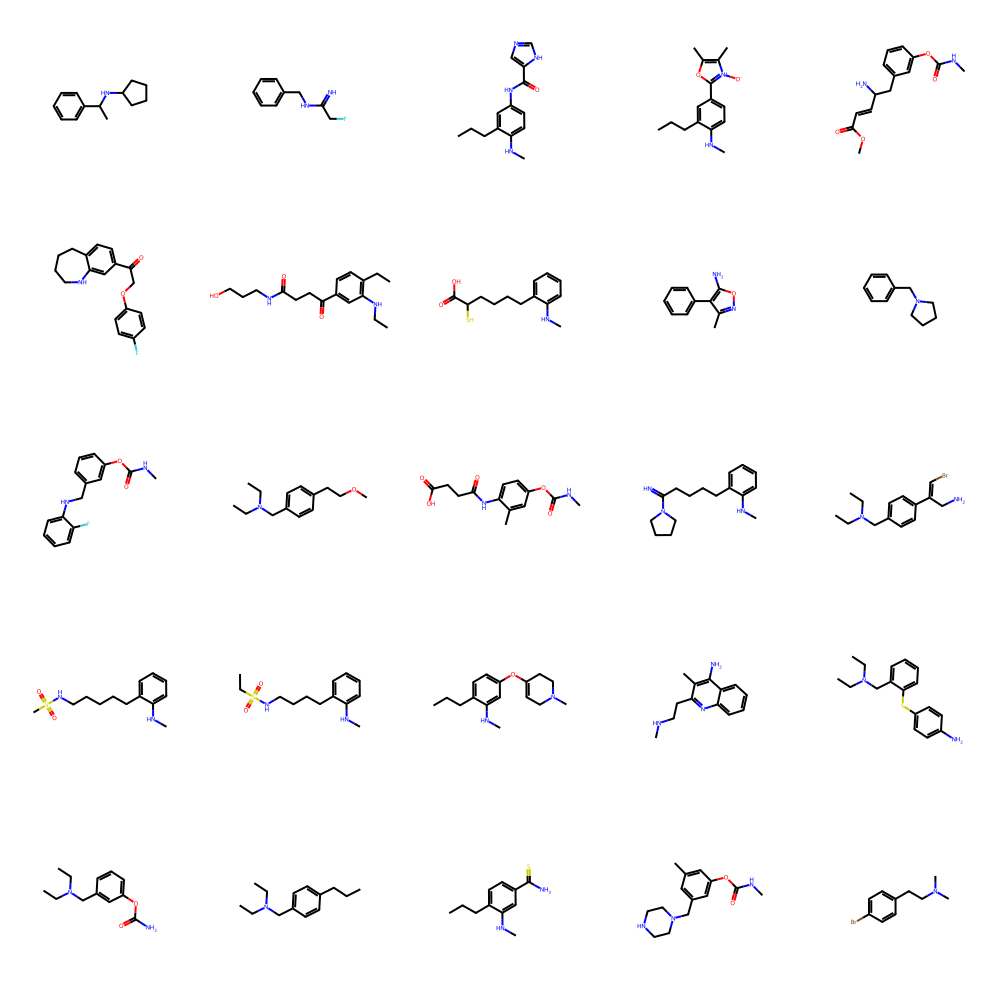

In [358]:
!git clone https://github.com/PatWalters/fragment_expansion.git
%cd /content/fragment_expansion
!pip install crem
!pip install rdkit
%load /content/fragment_expansion/reos.py

from rdkit import Chem
from crem.crem import grow_mol
from rdkit.Chem.Scaffolds.MurckoScaffold import GetScaffoldForMol
from rdkit.Chem import AllChem
from rdkit.Chem.Draw import MolsToGridImage
from reos import REOS
import random
from rdkit.Chem.rdmolops import RemoveHs
import pandas as pd

# List of fragment SMILES strings
frag_smi_list = df_fragment_10['Fragment_SMILES']

# Initialize lists to store expanded and filtered molecules
expanded_mol_list = []
filtered_mol_list = []

# Iterate over each fragment SMILES
for frag_smi in frag_smi_list:
    # Convert fragment SMILES to RDKit molecule
    frag_mol = Chem.MolFromSmiles(frag_smi)

    if frag_mol is None:
        continue

    # Compute 2D coordinates for visualization
    AllChem.Compute2DCoords(frag_mol)

    # Specify the CReM database file
    crem_db_file = '/content/drive/MyDrive/replacements02_sc2.5.db'

    # Use the most general form of the grow_mol function
    grow_list = list(grow_mol(frag_mol, db_name=crem_db_file, max_atoms=8, return_mol=True))
    mol_list = [RemoveHs(x[1]) for x in grow_list]
    _ = [AllChem.GenerateDepictionMatching2DStructure(m, frag_mol) for m in mol_list]

    print(f"Number of molecules generated from fragment '{frag_smi}': {len(mol_list)}")

    # Use REOS class to filter out undesirable molecules
    reos = REOS("bms_filters.csv")
    filtered_mols = [x for x in mol_list if reos.eval_mol(x)]
    print(f"Number of filtered molecules: {len(filtered_mols)}")

    # Append to overall lists
    expanded_mol_list.extend(mol_list)
    filtered_mol_list.extend(filtered_mols)

# Display a sample of the generated and filtered molecules
random.shuffle(filtered_mol_list)
MolsToGridImage(filtered_mol_list[:25], molsPerRow=5)


In [359]:
from rdkit import Chem

generated_compoundSmiles_10 = []

for mol in filtered_mol_list:
    try:
        smiles = Chem.MolToSmiles(mol)
        generated_compoundSmiles_10.append(smiles)
    except Chem.rdchem.AtomValenceException:
        print(f"Skipping molecule with invalid valence: {mol}")
    except Chem.rdchem.KekulizeException:
        print(f"Skipping molecule with kekulization issues: {mol}")
    except Chem.rdchem.MolSanitizeException:
        print(f"Skipping molecule with sanitization issues: {mol}")


In [360]:
generated_compoundSmiles_10=pd.DataFrame(generated_compoundSmiles_10)

In [362]:
generated_compoundSmiles_10.to_csv('inhibitor_fragment_10.csv', index=False)

In [363]:
dataset_file = 'inhibitor_fragment_10.csv'
task = []
featurizer_func =dc.feat.CircularFingerprint(size=1024, radius=4)

loader = dc.data.CSVLoader(tasks=task, feature_field='0', featurizer=featurizer_func)
fragment_dataset_10 = loader.create_dataset(dataset_file)

Streaming output truncated to the last 5000 lines.
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:27:00] DEPRECATION WARNING: please use MorganGenerator
[01:2

In [364]:
X = scaler.fit_transform(fragment_dataset_10.X)
# Get predicted probabilities for each class
y_probs = best_model.predict_proba(X)

In [365]:
y_prob_negative = y_probs[:, 0]  # Probability for the negative class
y_prob_positive = y_probs[:, 1]  # Probability for the positive class

In [366]:
y_prob_positive

array([0.22      , 0.08666667, 0.34      , ..., 0.19      , 0.22      ,
       0.16666667])

In [367]:
df_fragmentDataset_10 = pd.DataFrame({'Smiles': fragment_dataset_10.ids, 'Postive Prediction': y_probs[:, 1]})


In [369]:
filtered_dfa_10 = df_fragmentDataset_10[df_fragmentDataset_10['Postive Prediction'] > 0.8]


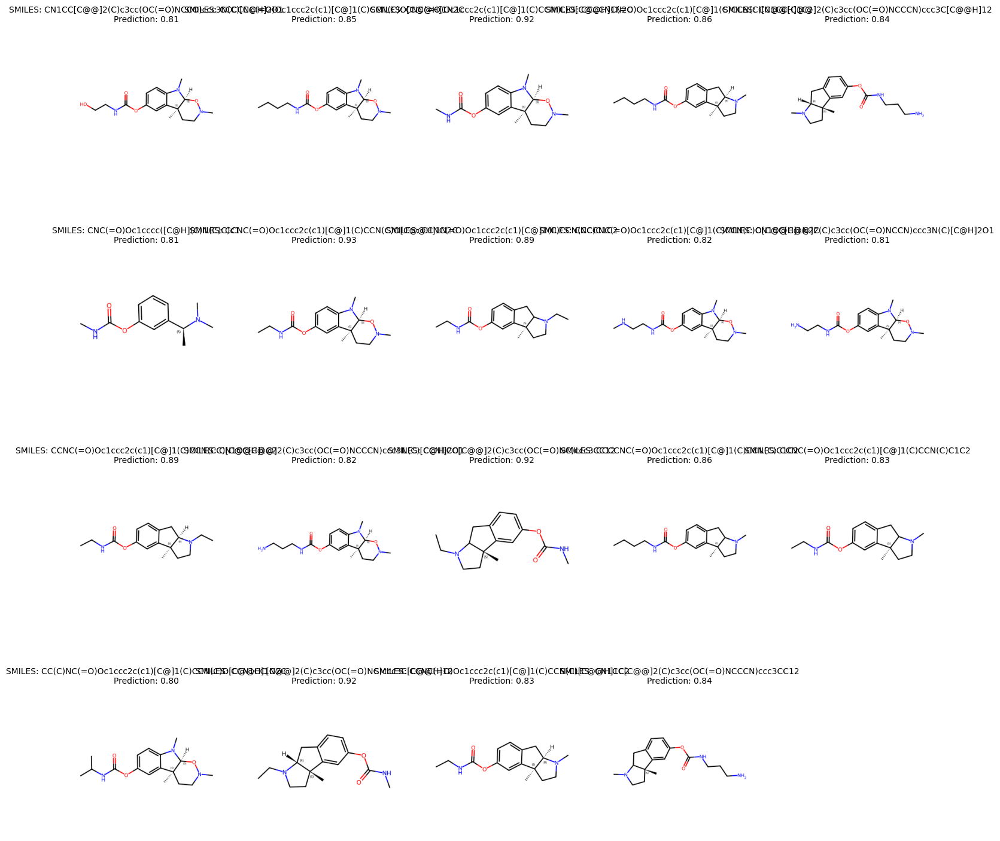

In [370]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
import matplotlib.pyplot as plt
import io
from PIL import Image


# Convert SMILES to RDKit Mol objects
filtered_dfa_10['Mol'] = filtered_dfa_10['Smiles'].apply(Chem.MolFromSmiles)

# Function to create a high-quality image of a molecule
def mol_to_image(mol, size=(300, 300)):
    d2d = rdMolDraw2D.MolDraw2DCairo(size[0], size[1])
    d2d.drawOptions().addAtomIndices = False
    d2d.drawOptions().addStereoAnnotation = True
    d2d.DrawMolecule(mol)
    d2d.FinishDrawing()
    img_data = d2d.GetDrawingText()
    return Image.open(io.BytesIO(img_data))

# Draw molecular structures
images = [mol_to_image(mol) for mol in filtered_dfa['Mol']]

# Set up plotting parameters
num_images = len(images)
num_cols = 5  # Number of molecules per row
fig_width = 15  # Total figure width in inches
row_height = 3.5  # Height per row in inches
num_rows = (num_images + num_cols - 1) // num_cols  # Calculate number of rows needed

# Create the figure and axes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(fig_width, row_height * num_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each molecule
for i, (img, smiles, pred) in enumerate(zip(images, filtered_dfa['Smiles'], filtered_dfa['Postive Prediction'])):
    ax = axes[i]
    ax.imshow(img)
    ax.set_title(f'SMILES: {smiles}\nPrediction: {pred:.2f}', fontsize=10)
    ax.axis('off')

# Remove any unused subplots
for j in range(num_images, num_rows * num_cols):
    axes[j].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.subplots_adjust(hspace=0.5)  # Adjust vertical spacing between rows
plt.show()


### Fragment visualization

In [394]:
parent_compounds=pd.DataFrame(test_datasetb.ids, columns=['Smiles'])

[02:51:10] DEPRECATION WARNING: please use MorganGenerator
[02:51:13] DEPRECATION WARNING: please use MorganGenerator
[02:51:16] DEPRECATION WARNING: please use MorganGenerator
[02:51:19] DEPRECATION WARNING: please use MorganGenerator
[02:51:21] DEPRECATION WARNING: please use MorganGenerator
[02:51:23] DEPRECATION WARNING: please use MorganGenerator
[02:51:25] DEPRECATION WARNING: please use MorganGenerator
[02:51:27] DEPRECATION WARNING: please use MorganGenerator
[02:51:30] DEPRECATION WARNING: please use MorganGenerator
[02:51:33] DEPRECATION WARNING: please use MorganGenerator
[02:51:33] non-ring atom 6 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 1 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring atom 0 marked aromatic
[02:51:33] non-ring ato

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [2, 3] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [9, 11] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Highlighting atoms: [11, 17, 15, 18] with color (0, 255, 0)
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [9, 11, 12] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757

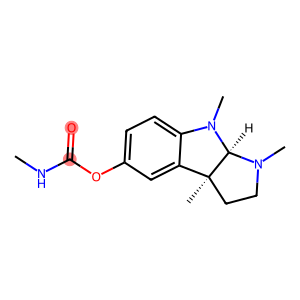

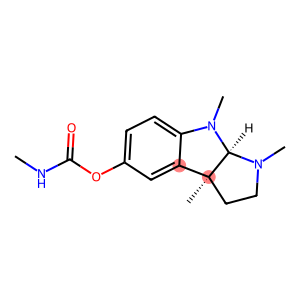

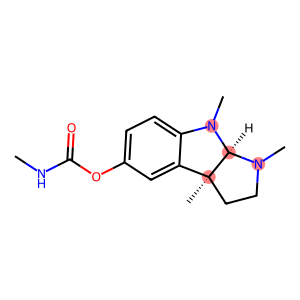

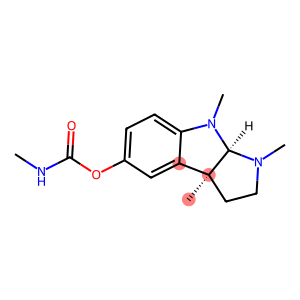

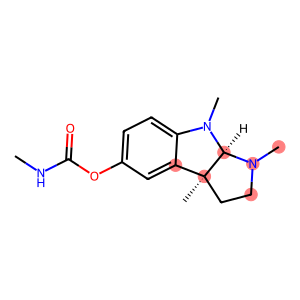

...

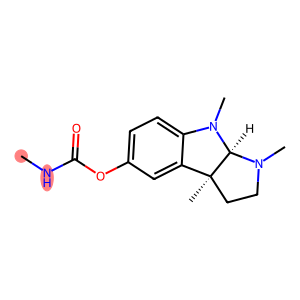

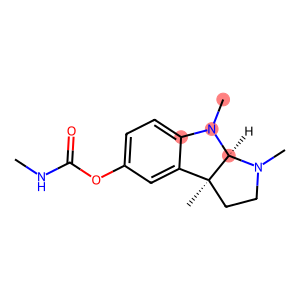

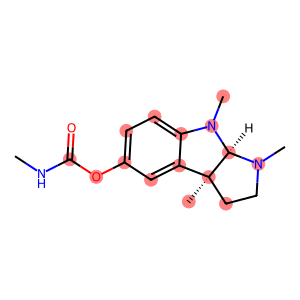

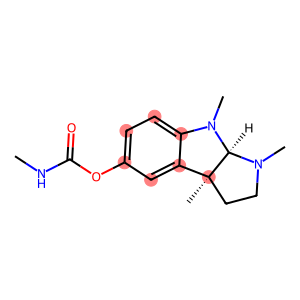

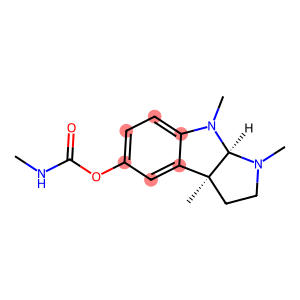

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [2, 14] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [2, 14, 13] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Fragment SMILES: CCC1Cc2cc(O)c(OC)cc2C1=O, Weight: -0.0018903212875906442
Fragment SMILES: CCCN(C)C, Weigh

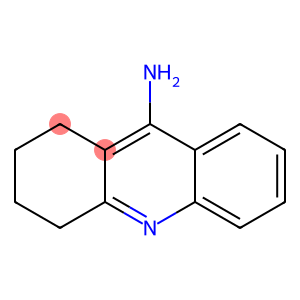

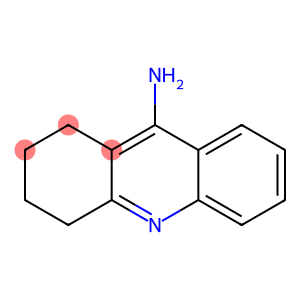

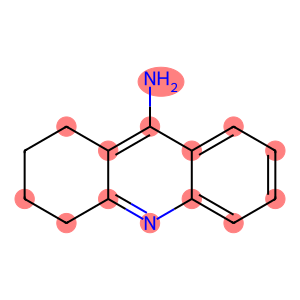

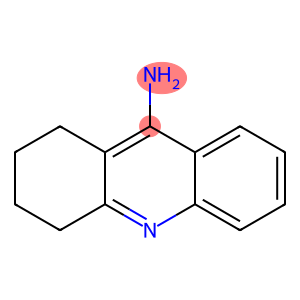

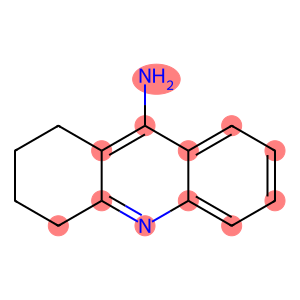

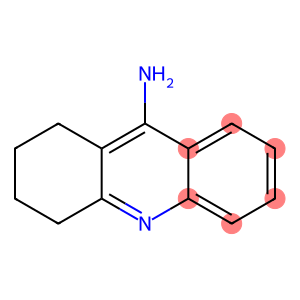

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Highlighting atoms: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17] with color (0, 0, 255)
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [13, 14] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [0, 1] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Highlighting atoms: [6, 5, 7, 4, 3, 2, 17] with color (0, 0, 255)
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Highlighting atoms: [4, 3, 17, 2, 8, 7, 10] with color (0, 0, 255)
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Highlighting atoms: [0, 1, 2, 3, 8] with color (0, 0, 255)
Fragment SMILES: CCC, Weight: -0.06458156769262118
Hi

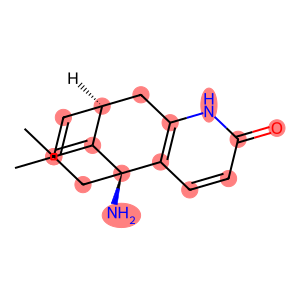

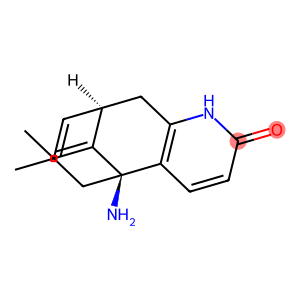

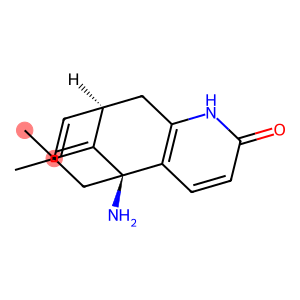

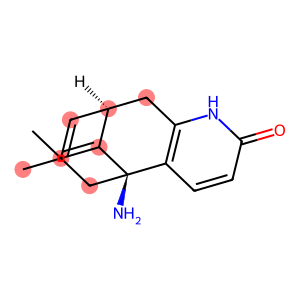

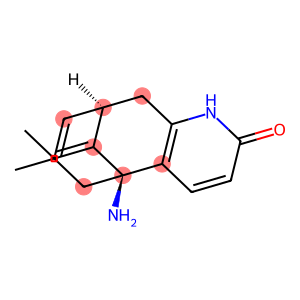

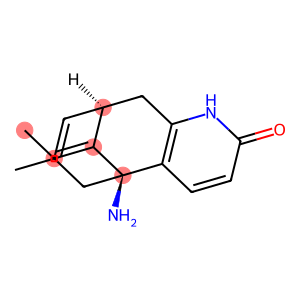

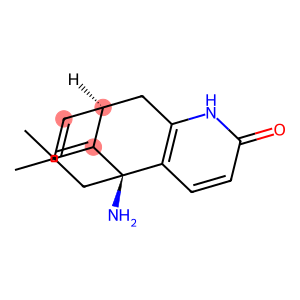

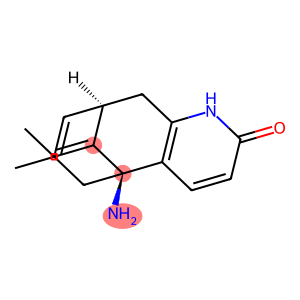

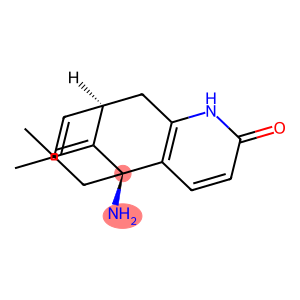

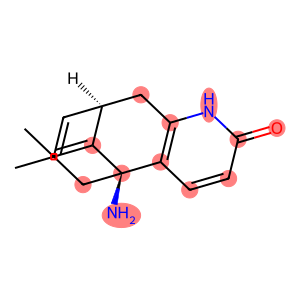

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [10, 11] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [4, 27] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Highlighting atoms: [10, 12, 27, 13, 14, 15, 26] with color (0, 0, 255)
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [4, 27, 12] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Highlighting atoms: [4, 27, 12, 10, 5, 13,

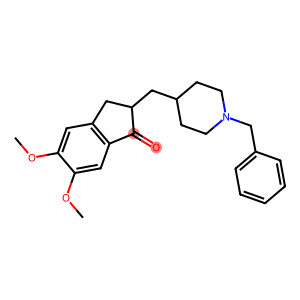

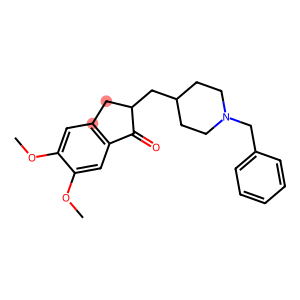

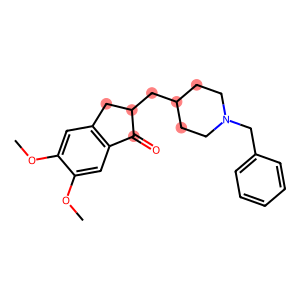

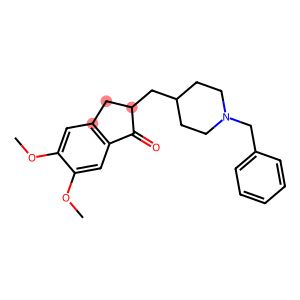

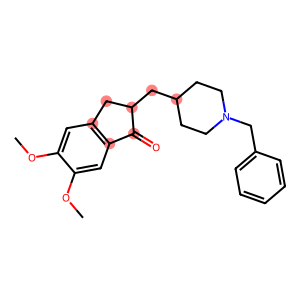

...

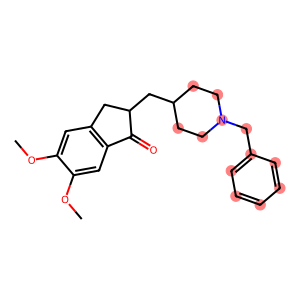

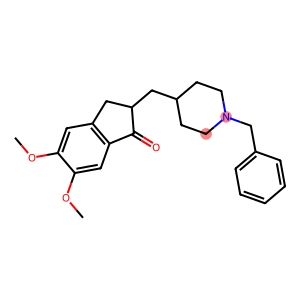

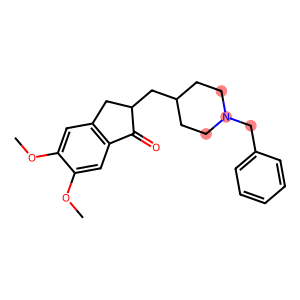

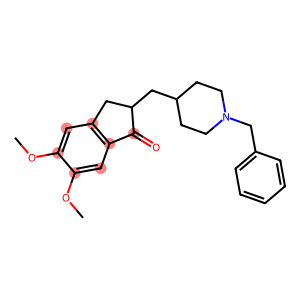

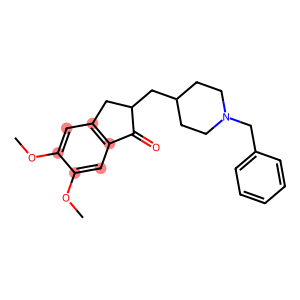

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [1, 0] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [1, 2] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Highlighting atoms: [2, 1, 0, 17, 18, 19, 20, 27, 21, 22] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Highlighting atoms: [2, 1, 0, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27] with color (0, 0, 255)
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [1, 2, 3] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.001747519227986092

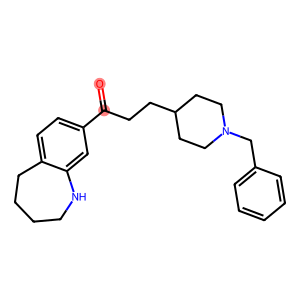

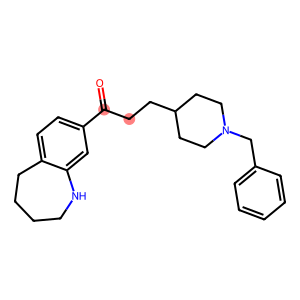

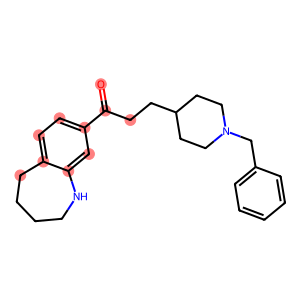

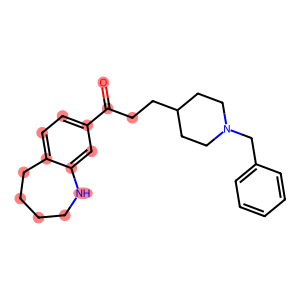

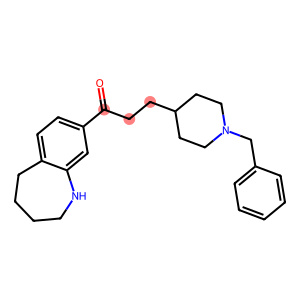

...

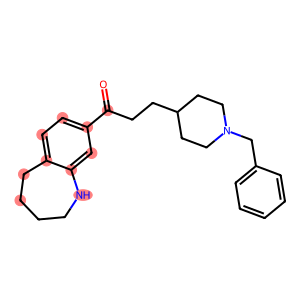

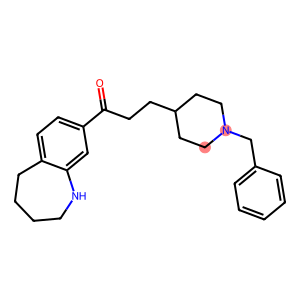

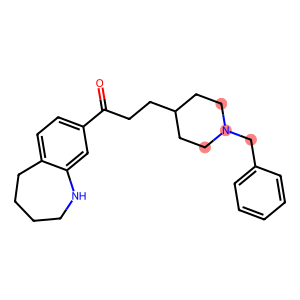

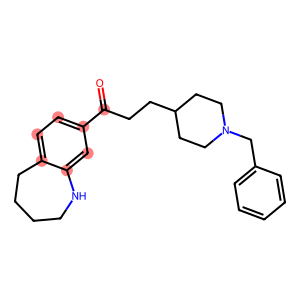

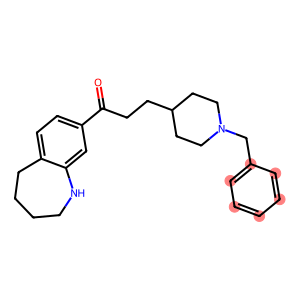

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [5, 20] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [6, 15, 14] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Fragment SMILES: CCC1Cc2cc(O)c(OC)cc2C1=O, Weight: -0.0018903212875906442
Fragment SMILES: CCCN(C)C, Weigh

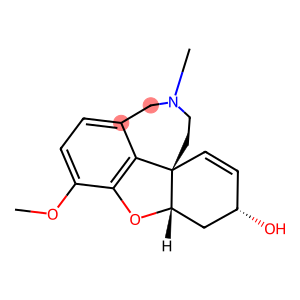

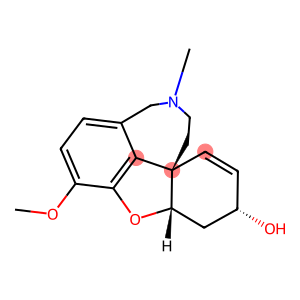

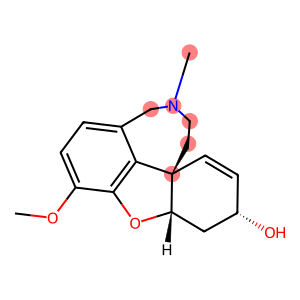

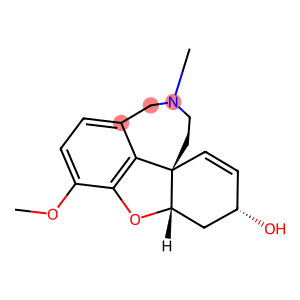

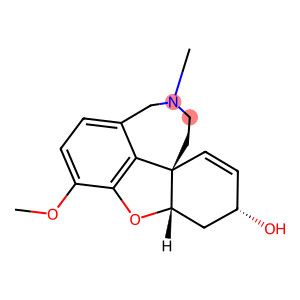

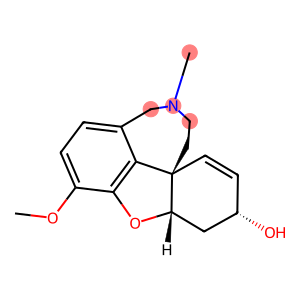

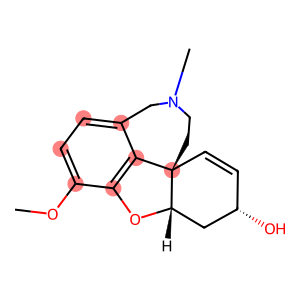

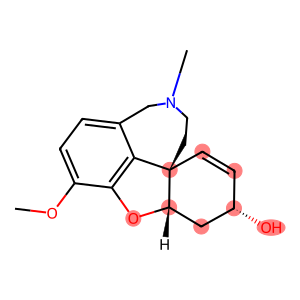

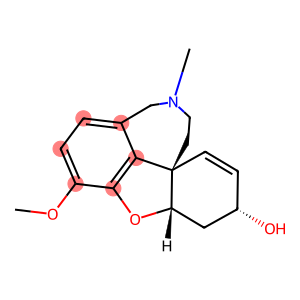

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [4, 5] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [0, 1] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [11, 12, 13] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Fragment SMILES: CCC1Cc2cc(O)c(OC)cc2C1=O, Weight: -0.00

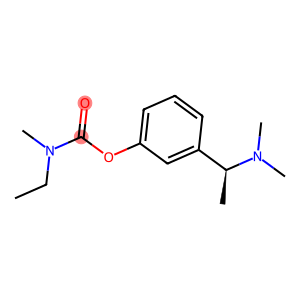

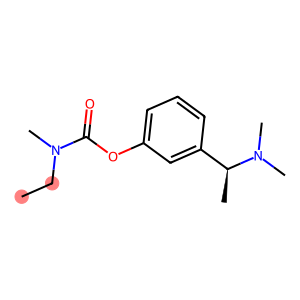

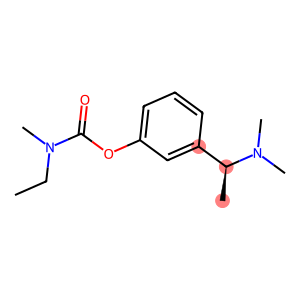

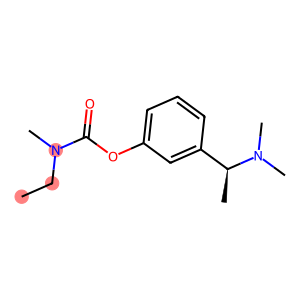

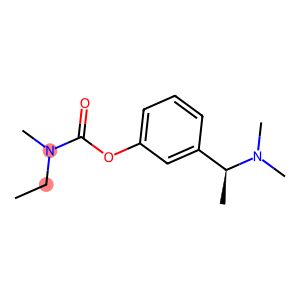

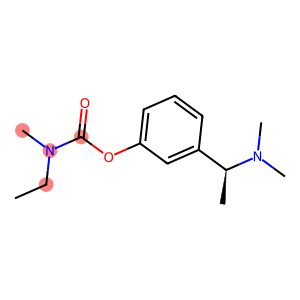

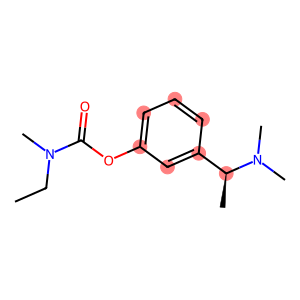

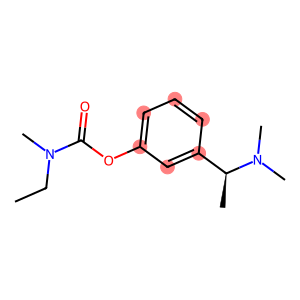

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Highlighting atoms: [3, 4] with color (0, 0, 255)
Fragment SMILES: CC, Weight: 0.001859235805871782
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Fragment SMILES: CCC1Cc2cc(O)c(OC)cc2C1=O, Weight: -0.0018903212875906442
Fragment SMILES: CCCN(C)C, Weight: 0.14805460603053733
Fragment SMILES: CCCc1ccccc1NC, W

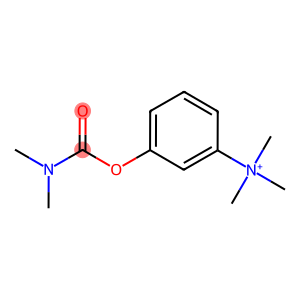

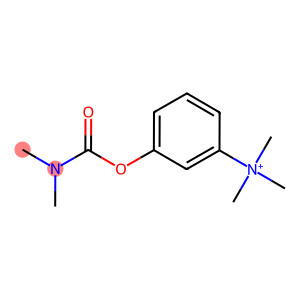

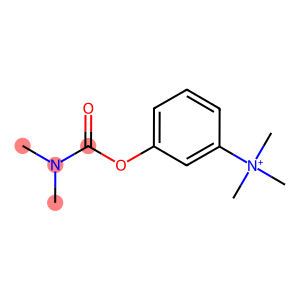

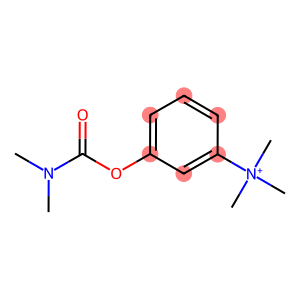

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [0, 1] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Fragment SMILES: CCC1Cc2cc(O)c(OC)cc2C1=O, Weight: -0.0018903212875906442
Fragment SMILES: CCCN(C)C, Weight: 0.14805460603053733
Fragment SMILES: CCCc1ccccc1NC, W

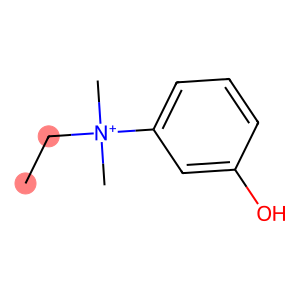

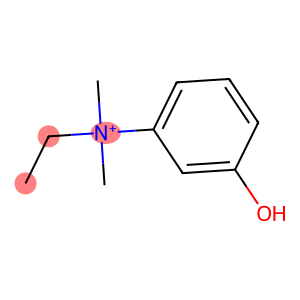

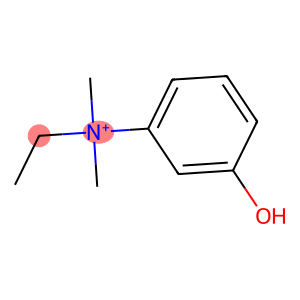

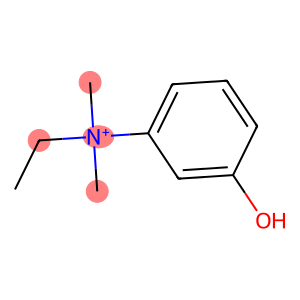

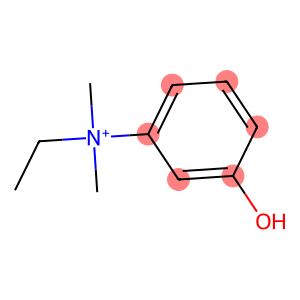

Fragment SMILES: C=C1[C@H]2C=CC[C@@]1(N)c1ccc(=O)[nH]c1C2, Weight: 0.017436431812994587
Fragment SMILES: C=O, Weight: 0.00837335916134344
Fragment SMILES: CC, Weight: 0.001859235805871782
Highlighting atoms: [6, 7] with color (0, 0, 255)
Fragment SMILES: CC(=O)c1ccc(C)cc1, Weight: 0.004989248709261571
Fragment SMILES: CC(=O)c1ccc2c(c1)NCCCC2, Weight: 0.03457477827954405
Fragment SMILES: CC(C)=CC(C)C, Weight: 0.02022983273919612
Fragment SMILES: CC(C)CC(C)C, Weight: 0.0031028448548036554
Fragment SMILES: CC(N)N, Weight: -0.01726661151449139
Fragment SMILES: CC=C(C)C, Weight: 0.0016408191608785346
Fragment SMILES: CCC, Weight: -0.06458156769262118
Highlighting atoms: [6, 7, 8] with color (0, 255, 0)
Fragment SMILES: CCC(=O)c1cccc(N)c1, Weight: 0.0017475192279860926
Fragment SMILES: CCC(CC)CC, Weight: 0.026627796764994258
Highlighting atoms: [7, 8, 9, 10, 11, 21, 20] with color (0, 0, 255)
Fragment SMILES: CCC1CCN(C)CC1, Weight: 0.04794989844757146
Highlighting atoms: [7, 8, 9, 10, 11, 12

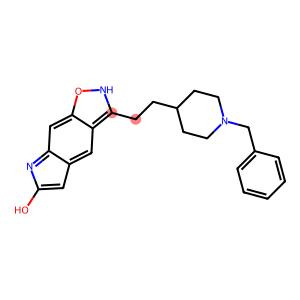

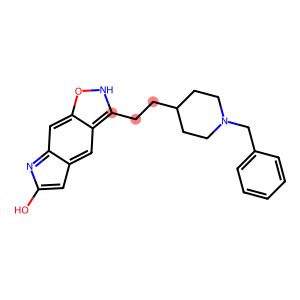

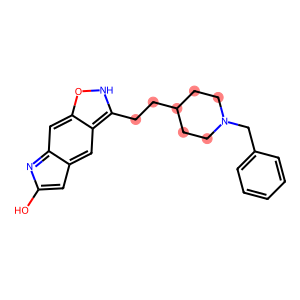

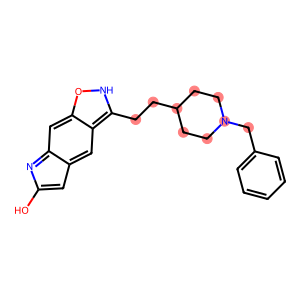

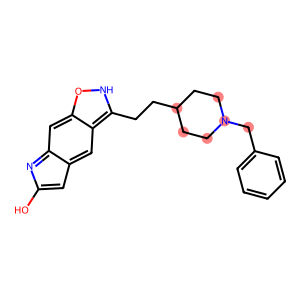

...

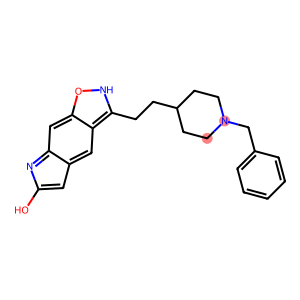

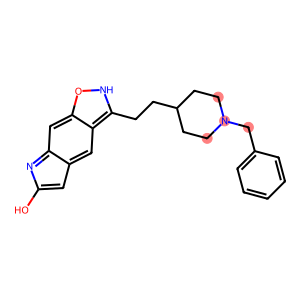

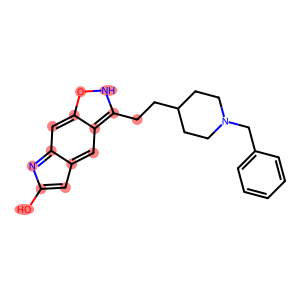

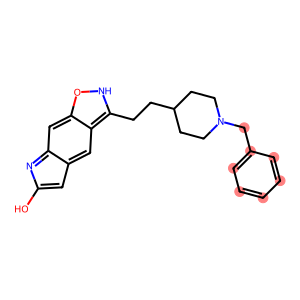

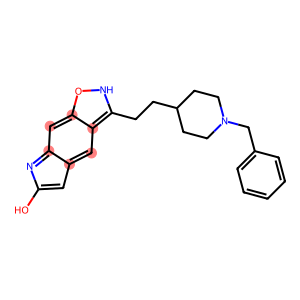

In [388]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from PIL import Image


all_data = []

# Get positive IDs
positive_ids = list(range(len(test_datasetb.ids)))

# Iterate over positive IDs
for positive_id in positive_ids:
    explain = explainer.explain_instance(test_features_10[positive_id], best_model_evaluator, num_features=100, top_labels=1)

    # Generate molecule from SMILES
    molecule = Chem.MolFromSmiles(test_datasetb.ids[positive_id])
    fragments_activations = generate_circular_fingerprint_dict(molecule)

    for label in explain.top_labels:
        fragment_weight = dict(explain.as_map()[label])

        data = [
            {'ID': positive_id, 'Label': label, 'Index': index, 'fragments_activations': fragments_activations[index], 'Fragment_Weight': fragment_weight[index]}
            for index in fragments_activations if index in fragment_weight
        ]

        all_data.extend(data)

# Create a DataFrame from the combined data
df = pd.DataFrame(all_data)

# Extract fragments from 'fragments_activations' column
df['fragments'] = df['fragments_activations'].apply(lambda x: extract_fragments(x))

# Explode the 'fragments' column to have one fragment per row
exploded_df = df.explode('fragments')

# Ensure only valid molecules are processed
exploded_df['fragments'] = exploded_df['fragments'].apply(lambda x: x if isinstance(x, Chem.Mol) else None)
exploded_df = exploded_df.dropna(subset=['fragments'])

# Convert fragments to SMILES strings
exploded_df['Fragment_SMILES'] = exploded_df['fragments'].apply(Chem.MolToSmiles)

# Group by fragment SMILES and aggregate weights
aggregated_df = exploded_df.groupby('Fragment_SMILES').agg({'Fragment_Weight': 'sum'}).reset_index()

# Function to map and highlight fragments on the parent structure
def map_and_highlight_fragments(row, parent_molecule):
    fragment_smiles = row['Fragment_SMILES']
    fragment_weight = row['Fragment_Weight']

    print(f"Fragment SMILES: {fragment_smiles}, Weight: {fragment_weight}")

    if fragment_smiles == '{}':  # Handle empty fragments
        return None

    fragment_molecule = Chem.MolFromSmiles(fragment_smiles)

    if fragment_molecule is None:
        return None

    if parent_molecule.HasSubstructMatch(fragment_molecule):
        match_atoms = parent_molecule.GetSubstructMatch(fragment_molecule)
        highlight_atoms = list(match_atoms)

        if fragment_weight > 0:
            highlight_color = (0, 0, 255)  # Blue (RGB format)
        else:
            highlight_color = (0, 255, 0)  # Red (RGB format)

        print(f"Highlighting atoms: {highlight_atoms} with color {highlight_color}")

        highlight_colors = {atom: highlight_color for atom in highlight_atoms}
        highlighted_img = Draw.MolToImage(parent_molecule, highlightAtoms=highlight_atoms, highlightAtomColors=highlight_colors, size=(300, 300))
        return highlighted_img
    else:
        return None  # Return None if no match found

# Generate images with highlighted fragments for each positive_id
for positive_id in positive_ids:
    parent_smiles = test_datasetb.ids[positive_id]
    parent_molecule = Chem.MolFromSmiles(parent_smiles)

    fragment_df = aggregated_df.copy()  # Create a copy of the aggregated DataFrame to avoid modifications in-place
    fragment_df['Parent_Molecule_Image'] = fragment_df.apply(map_and_highlight_fragments, parent_molecule=parent_molecule, axis=1)

    # Display images of parent structures with highlighted fragments
    for idx, row in fragment_df.iterrows():
        if row['Parent_Molecule_Image'] is not None:
            display(row['Parent_Molecule_Image'])


## References

* Jiménez-Luna, J., Grisoni, F., & Schneider, G. (2020). Drug discovery with explainable artificial intelligence. Nature Machine Intelligence, 2(10), 573–584. https://doi.org/10.1038/s42256-020-00236-4
* Ribeiro, M. T., Singh, S., & Guestrin, C. (2016). “Why Should I Trust You?”: Explaining the Predictions of Any Classifier (arXiv:1602.04938). arXiv. http://arxiv.org/abs/1602.04938
* Rogers, D., & Hahn, M. (2010). Extended-Connectivity Fingerprints. Journal of Chemical Information and Modeling, 50(5), 742–754. https://doi.org/10.1021/ci100050t
* https://colab.research.google.com/github/deepchem/deepchem/blob/master/examples/tutorials/Introduction_to_Model_Interpretability.ipynb
*Ramsundar, B., Eastman, P., Walters, P., Pande, V., Leswing, K., & Wu, Z. (2019). Deep Learning for the Life Sciences. O’Reilly Media. https://www.amazon.com/Deep-Learning-Life-Sciences-Microscopy/dp/1492039837
*   Vignaux, P. A., Lane, T. R., Urbina, F., Gerlach, J., Puhl, A. C., Snyder, S. H., & Ekins, S. (2023). Validation of Acetylcholinesterase Inhibition Machine Learning Models for Multiple Species. Chemical Research in Toxicology, 36(2), 188–201. https://doi.org/10.1021/acs.chemrestox.2c00283

*  